In [2]:
import scanpy as sc
import anndata
import pandas as pd
import numpy as np

In [1]:
import session_info
session_info.show()

In [3]:
adata = sc.read_h5ad('/nfs/team205/ac65/ALI_COVID19/datasets_integration_ALI/harmony_final_basaloid_subsets.h5ad')

In [4]:
adata

AnnData object with n_obs × n_vars = 614695 × 17591
    obs: 'n_genes', 'n_UMI', 'percent_mito', 'method', 'doublet', 'predicted_celltype', 'compartment', 'Cluster', 'SubCluster', 'Viral+', 'leiden_res_2', 'leiden_res_1.3', 'donor', 'disease', 'age', 'age_group', 'status', 'age_status', 'file_of_origin', 'sample_id', 'Sex', 'Age_bin', 'Group', 'Ethnicity_inferred', 'Smoker', 'COVID_status', 'COVID_severity', 'First_symptoms_hospitalisation_interval', 'First_symptoms_collection_interval', 'Positive_test_collection_interval', 'Sample_location', 'Kit_version', 'dataset', 'Sanger_sample_ID', 'Cell_type_annotation_level3', 'Cell_type_annotation_level1', 'Cell_type_annotation_level2', 'log1p_n_counts', 'log1p_n_genes', 'percent_ribo', 'n_counts_total_sarscov2', 'percent_total_sarscov2', 'n_counts_sarscov2', 'percent_sarscov2', 'scrublet_score', 'donor_id', 'Age', 'Peak_Respiratory_Support_WHO_Score', 'Bloody_Swab', 'Percent_Mitochondrial', 'SARSCoV2_PCR_Status', 'SARSCoV2_PCR_Status_and_WHO_

In [5]:
marker_genes_dict_2 = {'Basal1': ['DLK2', 'KRT5', 'KRT14','KRT15','TP63'],
                     'Basal2': ['DAPL1', 'NOTCH1', 'NOTCH3'],
                     'EMT': ['CDH1', 'CDH2', 'VIM', 'FN1', 'COL1A1', 'COL3A1', 'LAMA5', 'ITGB6', 'MMP7'], 
                     'Cycling basal': ['MKI67', 'NUSAP1'],
                     'Hillock': ['LY6D', 'KRT13', 'KRT4'], 
                     'Goblet 1': ['TFF3','SCGB1A1','MUC5AC','BPIFA2','MUC5B','TFF1'], 
                     'Goblet 2 BPIFA1+': ['BPIFA1'], 
                     'Goblet 2 PLAU+': ['PLAU'],
                     'Goblet 2 inflammatory': ['CXCL10', 'OAS1', 'IFIT1', 'IFIT3'],                 
                     'Secretory': ['NOS2', 'CAPN13', 'RARRES1', 'SERPINB3', 'AQP5', 'CP', 'PI3'],
                     #'Dev Secretory': [ 'KRT5', 'KRT15','COL7A1', 'FGFR3', 'EGFR', 'CMYA5'],
                     #'Transit epi 1': ['FP671120.4', 'FP236383.2'],
                     'Infected': ['ACE2', 'TMPRSS2'],
                     'Ciliated 1': ['OMG', 'PIFO', 'FOXJ1'], 
                     'Ciliated 2': ['CCDC40'],
                     'Deutorosomal': ['FOXN4', 'CDC20B'], 
                     'Ionocyte': ['FOXI1'], 
                     'Squamous': [ "KRT78"], 
                     'AT1': ['RTKN2', 'CLIC5'], 
                     'AT2': ['SFTPA1', 'SFTPA2', 'WIF1', 'HHIP', 'CA2', 'ETV5' , 'WIF1', 'HHIP']
                     }

/home/jovyan/my-conda-envs/celltypist/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


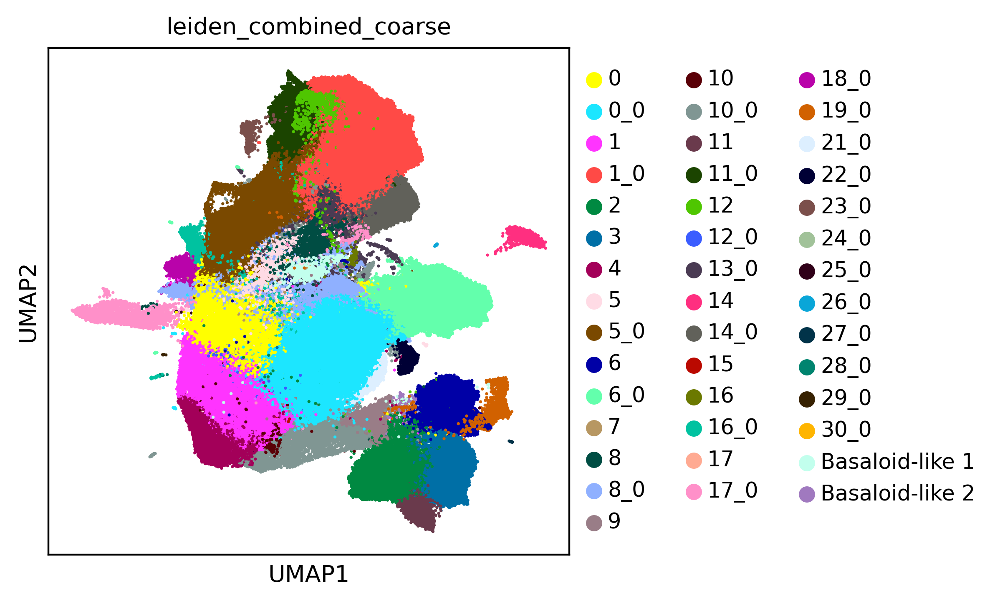

In [6]:
sc.set_figure_params(dpi=200, fontsize=10)
sc.pl.umap(adata, color = 'leiden_combined_coarse', size = 7)

# annotation of inflammatory cells

In [7]:
# Subset data for fine-tuning
clusters_to_refine = ['8', '8_0','14_0', "17", '1_0']  # Example: clusters to be fine-tuned
adata_refine = adata[adata.obs['leiden_combined_coarse'].isin(clusters_to_refine)]

In [8]:
adata_refine

View of AnnData object with n_obs × n_vars = 125864 × 17591
    obs: 'n_genes', 'n_UMI', 'percent_mito', 'method', 'doublet', 'predicted_celltype', 'compartment', 'Cluster', 'SubCluster', 'Viral+', 'leiden_res_2', 'leiden_res_1.3', 'donor', 'disease', 'age', 'age_group', 'status', 'age_status', 'file_of_origin', 'sample_id', 'Sex', 'Age_bin', 'Group', 'Ethnicity_inferred', 'Smoker', 'COVID_status', 'COVID_severity', 'First_symptoms_hospitalisation_interval', 'First_symptoms_collection_interval', 'Positive_test_collection_interval', 'Sample_location', 'Kit_version', 'dataset', 'Sanger_sample_ID', 'Cell_type_annotation_level3', 'Cell_type_annotation_level1', 'Cell_type_annotation_level2', 'log1p_n_counts', 'log1p_n_genes', 'percent_ribo', 'n_counts_total_sarscov2', 'percent_total_sarscov2', 'n_counts_sarscov2', 'percent_sarscov2', 'scrublet_score', 'donor_id', 'Age', 'Peak_Respiratory_Support_WHO_Score', 'Bloody_Swab', 'Percent_Mitochondrial', 'SARSCoV2_PCR_Status', 'SARSCoV2_PCR_Status_

In [9]:
sc.pp.neighbors(adata_refine)

         Falling back to preprocessing with `sc.pp.pca` and default params.


/home/jovyan/my-conda-envs/celltypist/lib/python3.10/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/jovyan/my-conda-envs/celltypist/lib/python3.10/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/jovyan/my-conda-envs/celltypist/lib/python3.10/site-packag

In [10]:
# Fine-tune Leiden clustering for selected clusters
sc.tl.leiden(adata_refine, resolution=0.1)  # Adjust resolution as needed

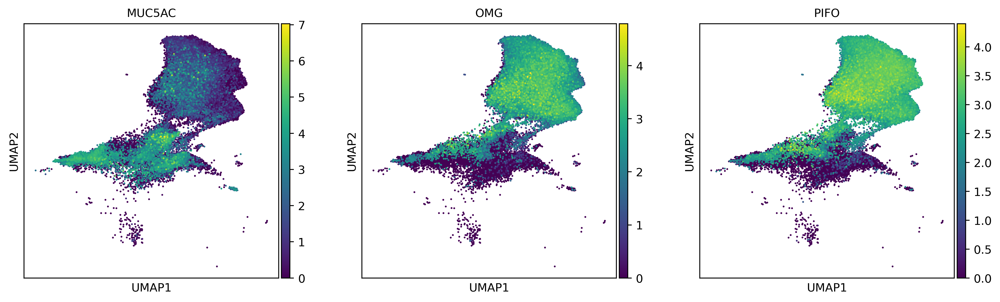

In [11]:
sc.pl.umap(adata_refine, color=['MUC5AC', 'OMG', 'PIFO'], ncols = 3, size = 10)

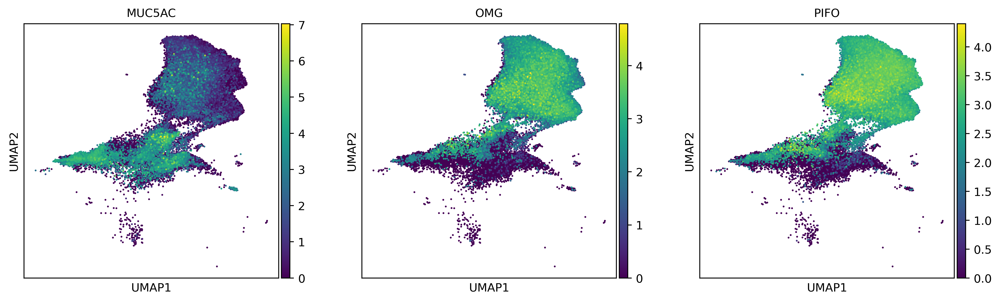

In [10]:
sc.pl.umap(adata_refine, color=['MUC5AC', 'OMG', 'PIFO'], ncols = 3, size = 10)

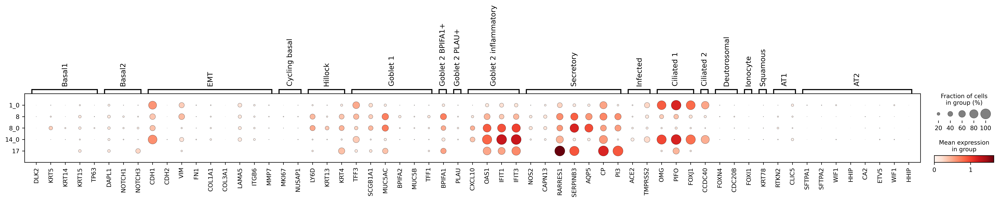

In [11]:
sc.pl.dotplot(adata_refine, marker_genes_dict_2, groupby='leiden_combined_coarse', log = True)

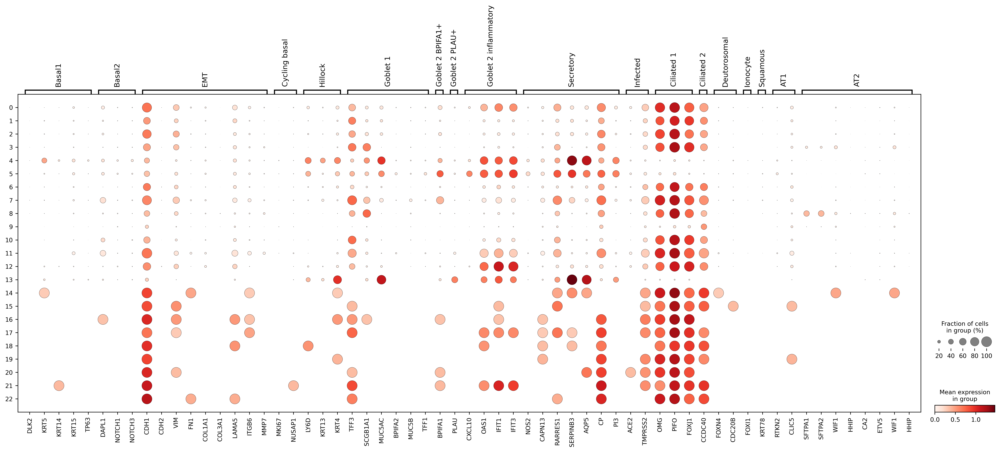

In [12]:
sc.pl.dotplot(adata_refine, marker_genes_dict_2, groupby='leiden', log = True)

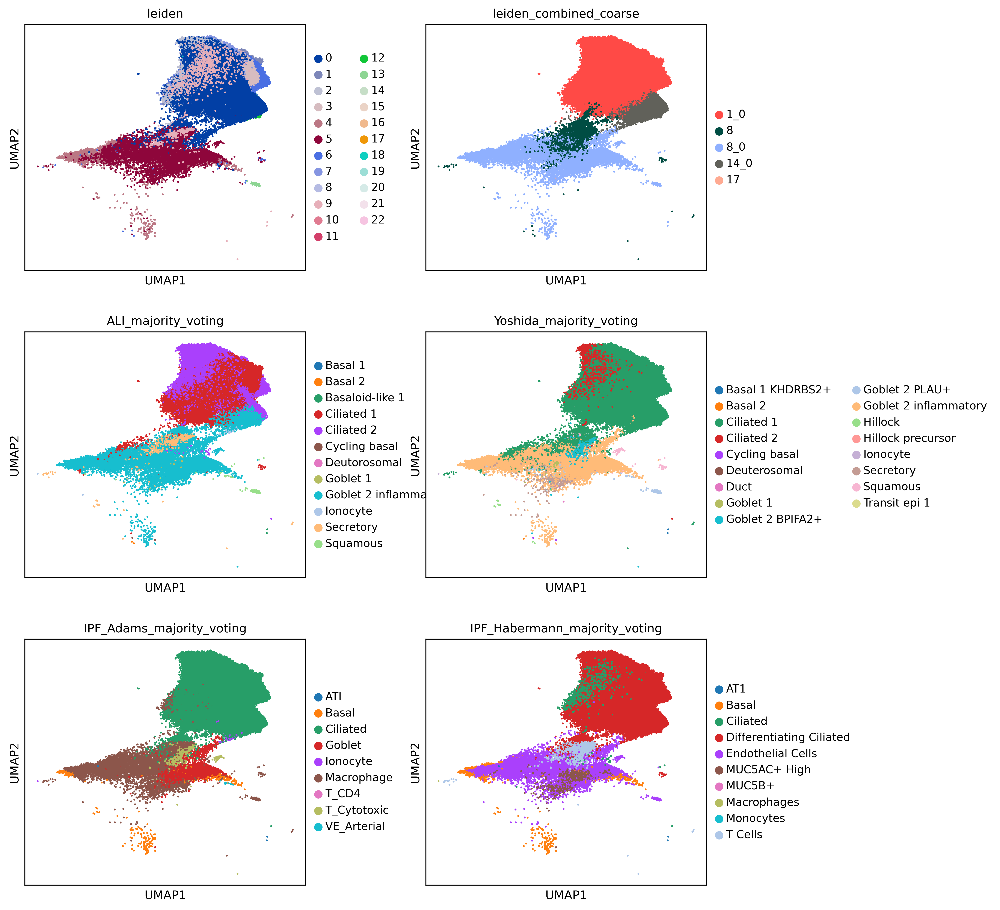

In [13]:
sc.pl.umap(adata_refine, color=['leiden', 'leiden_combined_coarse', 'ALI_majority_voting', 'Yoshida_majority_voting', 
                                'IPF_Adams_majority_voting', 'IPF_Habermann_majority_voting'], ncols = 2, size = 10, wspace = 0.3)

In [14]:
pd.crosstab(adata_refine.obs['leiden'], adata_refine.obs['leiden_combined_coarse'])

leiden_combined_coarse,1_0,8,8_0,14_0,17
leiden,,,,,
0,25478,619,518,5752,0
1,24261,103,0,106,0
2,21165,75,4,21,0
3,13442,10,5,17,0
4,3,954,8708,1,0
5,4,2829,5715,21,10
6,7655,607,78,133,1
7,2313,18,0,0,0
8,1567,9,0,10,0


In [15]:
np.unique(adata_refine.obs['leiden'])

array(['0', '1', '10', '11', '12', '13', '14', '15', '16', '17', '18',
       '19', '2', '20', '21', '22', '3', '4', '5', '6', '7', '8', '9'],
      dtype=object)

In [16]:
# Convert 'leiden' column to categorical
adata_refine.obs['leiden'] = pd.Categorical(adata_refine.obs['leiden'])

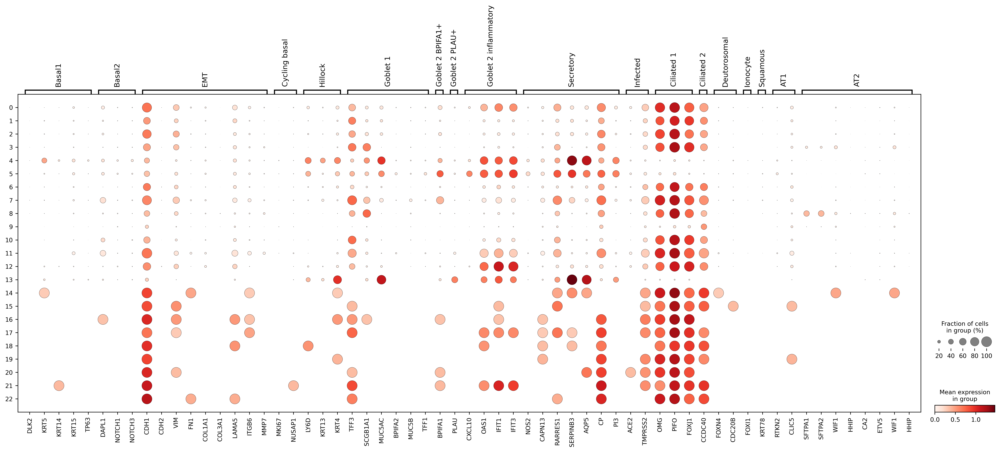

In [17]:
sc.pl.dotplot(adata_refine, marker_genes_dict_2, groupby='leiden', log = True)

In [18]:
adata_refine.obs['leiden'].replace({'0': 'Ciliated inflammatory',
                                    '6': 'Ciliated inflammatory',
                                    '7': 'Ciliated inflammatory',
                                    '10': 'Ciliated inflammatory',
                                    '11': 'Ciliated inflammatory',
                                    '12': 'Ciliated inflammatory',
                                    '17': 'Ciliated inflammatory',
                                    '21': 'Ciliated inflammatory',
                                    
                                    '1': 'Ciliated',
                                    '2': 'Ciliated',
                                    '3': 'Ciliated',
                                    '8': 'Ciliated',
                                    '9': 'Ciliated',
                                    '14': 'Ciliated',
                                    '15': 'Ciliated',
                                    '16': 'Ciliated',
                                    '18': 'Ciliated',
                                    '19': 'Ciliated',
                                    '20': 'Ciliated',
                                    '22': 'Ciliated',
                                    
                                    
                                    '4': 'Goblet inflammatory',
                                    '5': 'Goblet inflammatory',
                                    '13': 'Goblet inflammatory'}, inplace=True)

In [19]:
np.unique(adata_refine.obs['leiden'])

array(['Ciliated', 'Ciliated inflammatory', 'Goblet inflammatory'],
      dtype=object)

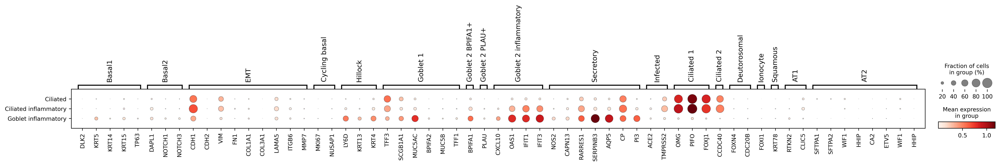

In [20]:
sc.pl.dotplot(adata_refine, marker_genes_dict_2, groupby='leiden', log = True)

In [21]:
# Assuming 'adata_refine' is your AnnData object

# Extract the 'leiden' column and indices from adata_refine.obs
leiden_data = adata_refine.obs[['leiden']]
indices = adata_refine.obs_names

# Create a DataFrame from the extracted data
df = pd.DataFrame(leiden_data, index=indices)

# Append the DataFrame to adata using AnnData.obs
adata.obs = adata.obs.join(df, how='left', rsuffix='_inflammatory')

In [22]:
adata.obs['leiden_inflammatory']

Delorey_2021_COVID_only.h5ad:02-P005175-S053-R01-AATCACGAGGGTCACA    NaN
Delorey_2021_COVID_only.h5ad:02-P005175-S053-R01-GGTAACTAGTCCTACA    NaN
Delorey_2021_COVID_only.h5ad:02-P005175-S053-R01-CATCCGTTCGCAAGAG    NaN
Delorey_2021_COVID_only.h5ad:02-P005175-S053-R01-TTCGGTCAGCTTTCCC    NaN
Delorey_2021_COVID_only.h5ad:02-P005175-S053-R01-TTAGGCATCCTCACTG    NaN
                                                                    ... 
Melms_2021.h5ad:AGCTTCCAGGCATGCA-1_27                                NaN
Melms_2021.h5ad:GCACGGTCAGAAGTTA-1_27                                NaN
Melms_2021.h5ad:TTGTGGATCATAGGCT-1_27                                NaN
Melms_2021.h5ad:GCCGATGAGTAAACGT-1_27                                NaN
Melms_2021.h5ad:AGGGTGAGTATCAGGG-1_27                                NaN
Name: leiden_inflammatory, Length: 614695, dtype: category
Categories (3, object): ['Ciliated', 'Ciliated inflammatory', 'Goblet inflammatory']

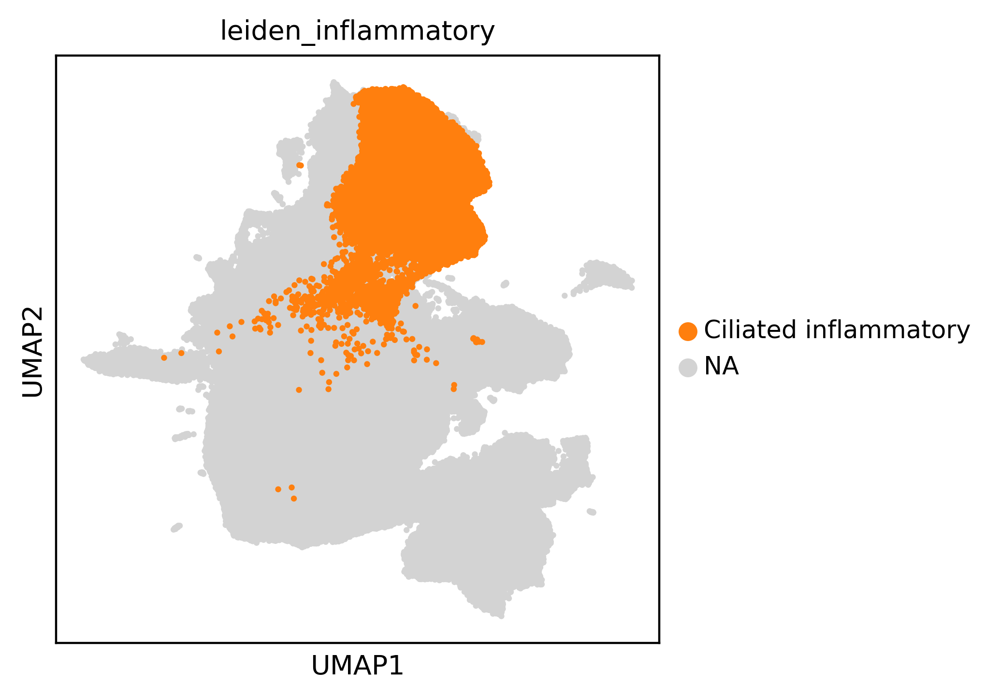

In [23]:
sc.pl.umap(adata, color = "leiden_inflammatory", groups = "Ciliated inflammatory", size = 20)

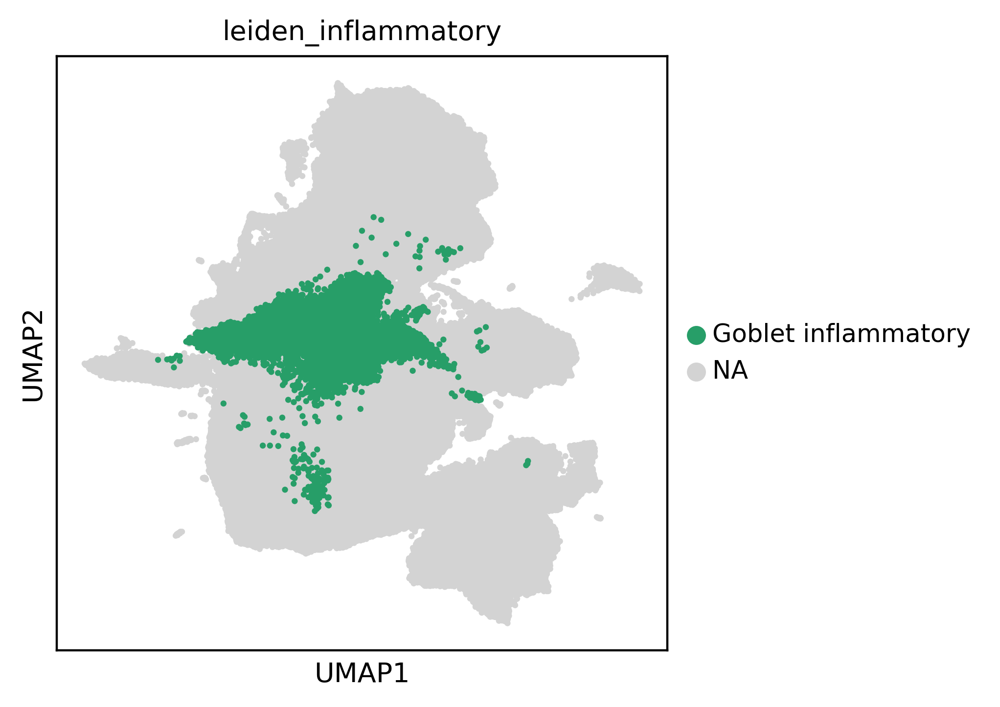

In [24]:
sc.pl.umap(adata, color = "leiden_inflammatory", groups = "Goblet inflammatory", size = 20)

In [27]:
adata.obs['leiden_inflammatory'] = adata.obs['leiden_inflammatory'].astype(str)

In [28]:
np.unique(adata.obs['leiden_inflammatory'])

array(['Ciliated', 'Ciliated inflammatory', 'Goblet inflammatory', 'nan'],
      dtype=object)

In [29]:
adata.obs['leiden_all'] = adata.obs['leiden_combined_coarse']
adata.obs['leiden_all'] = adata.obs['leiden_all'].astype(str)

In [30]:
matching_indices = adata.obs_names.isin(adata_refine.obs_names)
adata.obs.loc[matching_indices, 'leiden_all'] = adata.obs.loc[matching_indices, 'leiden_inflammatory']

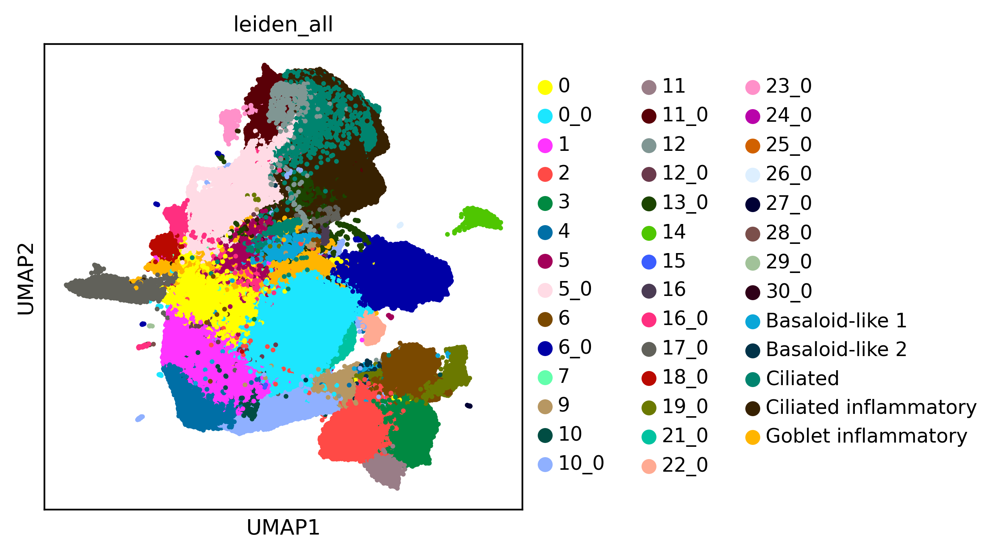

In [31]:
sc.pl.umap(adata, color = 'leiden_all', size = 20)

In [32]:
adata.obs['annotation_v1'] = adata.obs['leiden_all']

In [33]:
adata.obs['annotation_v1'].replace({'0': 'Goblet/Secretory'}, inplace=True)
adata.obs['annotation_v1'].replace({'0_0': 'Goblet/Secretory'}, inplace=True)
adata.obs['annotation_v1'].replace({'7': 'Goblet/Secretory'}, inplace=True)
adata.obs['annotation_v1'].replace({'5': 'Goblet/Secretory'}, inplace=True)
adata.obs['annotation_v1'].replace({'15': 'Goblet/Secretory'}, inplace=True)
adata.obs['annotation_v1'].replace({'16': 'Goblet/Secretory'}, inplace=True)
adata.obs['annotation_v1'].replace({'21_0': 'Goblet/Secretory'}, inplace=True)
adata.obs['annotation_v1'].replace({'24_0': 'Goblet/Secretory'}, inplace=True)
adata.obs['annotation_v1'].replace({'25_0': 'Goblet/Secretory'}, inplace=True)
adata.obs['annotation_v1'].replace({'26_0': 'Goblet/Secretory'}, inplace=True)
adata.obs['annotation_v1'].replace({'27_0': 'Goblet/Secretory'}, inplace=True)
adata.obs['annotation_v1'].replace({'28_0': 'Goblet/Secretory'}, inplace=True)
adata.obs['annotation_v1'].replace({'29_0': 'Goblet/Secretory'}, inplace=True)
adata.obs['annotation_v1'].replace({'30_0': 'Goblet/Secretory'}, inplace=True)
adata.obs['annotation_v1'].replace({'10_0': 'Goblet/Secretory'}, inplace=True)

adata.obs['annotation_v1'].replace({'9': 'Club'}, inplace=True)
adata.obs['annotation_v1'].replace({'12_0': 'Club'}, inplace=True)

adata.obs['annotation_v1'].replace({'1': 'Basal'}, inplace=True)
adata.obs['annotation_v1'].replace({'4': 'Basal'}, inplace=True)
adata.obs['annotation_v1'].replace({'22_0': 'Basal'}, inplace=True)

adata.obs['annotation_v1'].replace({'5_0': 'Ciliated'}, inplace=True)
adata.obs['annotation_v1'].replace({'11_0': 'Ciliated'}, inplace=True)
adata.obs['annotation_v1'].replace({'12': 'Ciliated'}, inplace=True)
adata.obs['annotation_v1'].replace({'13_0': 'Ciliated'}, inplace=True)
adata.obs['annotation_v1'].replace({'23_0': 'Ciliated'}, inplace=True)

adata.obs['annotation_v1'].replace({'2': 'AT2'}, inplace=True)
adata.obs['annotation_v1'].replace({'3': 'AT2'}, inplace=True)
adata.obs['annotation_v1'].replace({'11': 'AT2'}, inplace=True)
adata.obs['annotation_v1'].replace({'6': 'AT1'}, inplace=True)

adata.obs['annotation_v1'].replace({'10': 'Cycling basal'}, inplace=True)
adata.obs['annotation_v1'].replace({'6_0': 'Squamous'}, inplace=True)
adata.obs['annotation_v1'].replace({'16_0': 'Deutorosomal'}, inplace=True)
adata.obs['annotation_v1'].replace({'17_0': 'Ionocyte'}, inplace=True)
adata.obs['annotation_v1'].replace({'18_0': 'Transit epi'}, inplace=True)
adata.obs['annotation_v1'].replace({'19_0': 'KRT8+ DATPs'}, inplace=True)
adata.obs['annotation_v1'].replace({'14': 'Airway mucous'}, inplace=True)

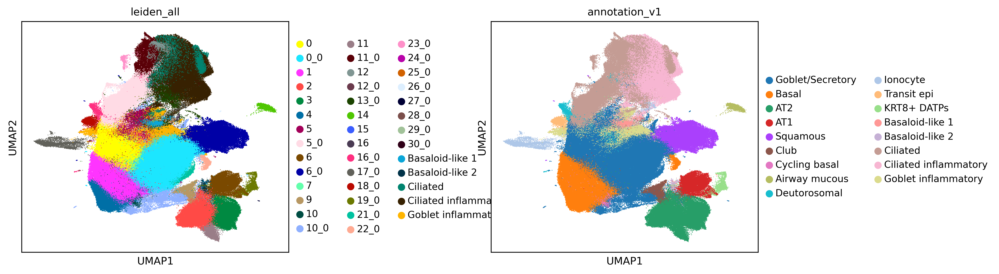

In [34]:
sc.set_figure_params(dpi=200, fontsize=10)
sc.pl.umap(adata, color = ['leiden_all', 'annotation_v1'], size = 2, wspace = 0.6)

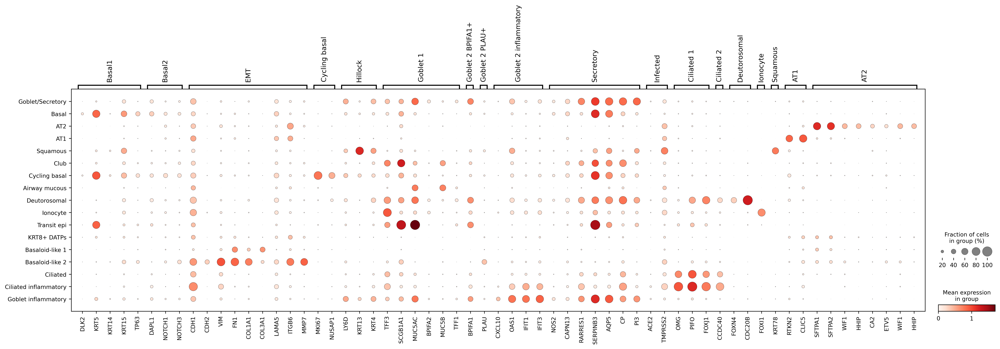

In [35]:
sc.pl.dotplot(adata, marker_genes_dict_2, groupby='annotation_v1', log = True)

In [ ]:
sc.tl.dendrogram(adata, 'annotation_v1')
sc.pl.dendrogram(adata, 'annotation_v1')

In [132]:
#adata.write('/nfs/team205/ac65/ALI_COVID19/datasets_integration_ALI/harmony_final_object_annv1.h5ad')

In [1]:
import scanpy as sc
import anndata
import pandas as pd
import numpy as np

In [2]:
adata = sc.read_h5ad('/nfs/team205/ac65/ALI_COVID19/datasets_integration_ALI/harmony_final_object_annv1.h5ad')

# show basaloid and goblet inf cells per age group

## basaloid

In [3]:
# Subset data to include only cells from Leiden cluster 13
subset_adata = adata[adata.obs['annotation_v1'] == 'Basaloid-like 2']

In [4]:
import matplotlib.pyplot as plt

# Group the data by leiden clusters and age groups
grouped_data = subset_adata.obs.groupby(['annotation_v1', 'age_status']).size().unstack()
grouped_data

age_status,adolescent-COVID19,adolescent-Healthy,adult-COVID19,adult-Healthy,adult-Other PF,elderly-COVID19,elderly-Healthy,elderly-IPF,elderly-Other PF,old_adult-COVID19,old_adult-Healthy,old_adult-IPF,old_adult-Other PF,paediatric-COVID19,paediatric-Healthy,young_adult-COVID19,young_adult-Healthy
annotation_v1,,,,,,,,,,,,,,,,,
Basaloid-like 2,35,1,11,6,1,111,20,244,1,207,6,110,80,83,29,54,4


In [5]:
subset_adata.obs['age_status'].value_counts()

elderly-IPF            244
old_adult-COVID19      207
elderly-COVID19        111
old_adult-IPF          110
paediatric-COVID19      83
old_adult-Other PF      80
young_adult-COVID19     54
adolescent-COVID19      35
paediatric-Healthy      29
elderly-Healthy         20
adult-COVID19           11
adult-Healthy            6
old_adult-Healthy        6
young_adult-Healthy      4
adolescent-Healthy       1
adult-Other PF           1
elderly-Other PF         1
Name: age_status, dtype: int64

In [6]:
subset_adata.obs['file_of_origin'].value_counts()

Bharat_2020.h5ad                695
Yoshida_2022.h5ad               132
Melms_2021.h5ad                 121
Loske_2021.h5ad                  21
Ziegler_2021.h5ad                13
Delorey_2021_COVID_only.h5ad     12
Chua_2020.h5ad                    5
Trump_2020.h5ad                   4
Name: file_of_origin, dtype: int64

In [7]:
subset_adata.obs['donor_harmonised'].value_counts()

PB 1            184
VUILD64         115
VUILD60          99
VUILD59          87
TX_Recipient     53
               ... 
NP37              1
NP39              1
D7                1
PP2               1
AP11              1
Name: donor_harmonised, Length: 103, dtype: int64

In [8]:
cluster_data = subset_adata.obs.groupby('age_status').size()
cluster_data.sort_values(ascending=False)

age_status
elderly-IPF            244
old_adult-COVID19      207
elderly-COVID19        111
old_adult-IPF          110
paediatric-COVID19      83
old_adult-Other PF      80
young_adult-COVID19     54
adolescent-COVID19      35
paediatric-Healthy      29
elderly-Healthy         20
adult-COVID19           11
adult-Healthy            6
old_adult-Healthy        6
young_adult-Healthy      4
adolescent-Healthy       1
adult-Other PF           1
elderly-Other PF         1
dtype: int64

In [9]:
# Group the filtered data by age groups and count the number of cells
grouped_data = adata.obs.groupby('age_status').size()
grouped_data.sort_values(ascending=False)

age_status
elderly-COVID19          96440
paediatric-Healthy       77802
old_adult-COVID19        61588
adult-COVID19            53440
paediatric-COVID19       49909
elderly-Healthy          41541
adolescent-COVID19       41277
adult-Healthy            38322
old_adult-Healthy        37351
adolescent-Healthy       34906
young_adult-COVID19      27279
elderly-IPF              17413
young_adult-Healthy      17388
old_adult-IPF             7464
adult-Post-COVID          5038
paediatric-Post-COVID     3545
old_adult-Other PF        3325
elderly-Other PF           473
adult-Other PF             194
dtype: int64

In [10]:
# Normalize the number of cells to a total of 5000 cells per age group
normalized_data = (cluster_data / grouped_data) * 5000

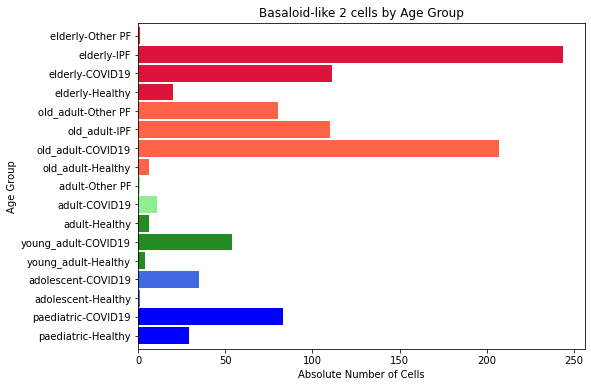

In [11]:
# Extract y-labels
y_labels = cluster_data.index

# Define the desired order of y-labels
desired_order = ['paediatric-Healthy', 'paediatric-COVID19', 'paediatric-Post-COVID', 'adolescent-Healthy', 'adolescent-COVID19',  
                'young_adult-Healthy' , 'young_adult-COVID19', 'adult-Healthy', 'adult-COVID19', 'adult-Post-COVID', 'adult-Other PF', 
                'old_adult-Healthy', 'old_adult-COVID19', 'old_adult-IPF', 'old_adult-Other PF', 'elderly-Healthy', 'elderly-COVID19', 'elderly-IPF', 'elderly-Other PF']  # Replace with your desired order

# Reorder y-labels
ordered_labels = [label for label in desired_order if label in y_labels]

# Create a list of colors corresponding to the reordered y-labels
colors = ['blue', 'blue', 'royalblue', 'royalblue', 
         'forestgreen', 'forestgreen', 'forestgreen', 'lightgreen', 'lightgreen', 
         "tomato", "tomato", "tomato", "tomato",
         "crimson", "crimson", "crimson", "crimson"]  # Replace with your desired colors

# Plot stacked bar plot with reordered y-labels and colors
plt.figure(figsize=(8, 6))
cluster_data.loc[ordered_labels].plot(kind='barh', stacked=True, color=colors, width=0.9)

# Set labels and title
plt.xlabel('Absolute Number of Cells')
plt.ylabel('Age Group')
plt.title('Basaloid-like 2 cells by Age Group')

# Remove grid lines
plt.grid(False)

# Show the plot
plt.show()

In [12]:
cluster_data = cluster_data[['paediatric-Healthy', 'paediatric-COVID19', 'adolescent-Healthy', 'adolescent-COVID19',  
              'young_adult-Healthy' , 'young_adult-COVID19', 'adult-Healthy', 'adult-COVID19',
             'old_adult-Healthy', 'old_adult-COVID19', 'elderly-Healthy', 'elderly-COVID19']]

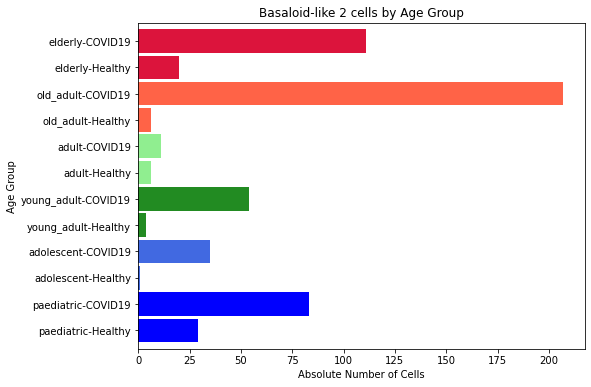

In [13]:
# Extract y-labels
y_labels = cluster_data.index

# Define the desired order of y-labels
desired_order = ['paediatric-Healthy', 'paediatric-COVID19', 'paediatric-Post-COVID', 'adolescent-Healthy', 'adolescent-COVID19',  
                'young_adult-Healthy' , 'young_adult-COVID19', 'adult-Healthy', 'adult-COVID19', 'adult-Post-COVID', 'adult-Other PF', 
                'old_adult-Healthy', 'old_adult-COVID19', 'old_adult-IPF', 'old_adult-Other PF', 'elderly-Healthy', 'elderly-COVID19', 'elderly-IPF', 'elderly-Other PF']  # Replace with your desired order

# Reorder y-labels
ordered_labels = [label for label in desired_order if label in y_labels]

# Create a list of colors corresponding to the reordered y-labels
colors = ['blue', 'blue', 'royalblue', 'royalblue', 
         'forestgreen', 'forestgreen', 'lightgreen', 'lightgreen', 
         "tomato", "tomato", "crimson", "crimson" ]  # Replace with your desired colors

# Plot stacked bar plot with reordered y-labels and colors
plt.figure(figsize=(8, 6))
cluster_data.loc[ordered_labels].plot(kind='barh', stacked=True, color=colors, width=0.9)

# Set labels and title
plt.xlabel('Absolute Number of Cells')
plt.ylabel('Age Group')
plt.title('Basaloid-like 2 cells by Age Group')

# Remove grid lines
plt.grid(False)

# Show the plot
plt.show()

In [14]:
normalized_data.sort_values(ascending=False)

age_status
old_adult-Other PF       120.300752
old_adult-IPF             73.687031
elderly-IPF               70.062597
adult-Other PF            25.773196
old_adult-COVID19         16.805222
elderly-Other PF          10.570825
young_adult-COVID19        9.897724
paediatric-COVID19         8.315134
elderly-COVID19            5.754873
adolescent-COVID19         4.239649
elderly-Healthy            2.407260
paediatric-Healthy         1.863705
young_adult-Healthy        1.150219
adult-COVID19              1.029192
old_adult-Healthy          0.803191
adult-Healthy              0.782840
adolescent-Healthy         0.143242
adult-Post-COVID                NaN
paediatric-Post-COVID           NaN
dtype: float64

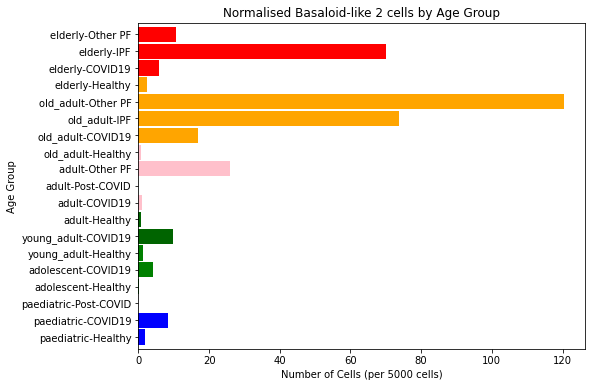

In [15]:
# Extract y-labels
y_labels = normalized_data.index

# Define the desired order of y-labels
desired_order = ['paediatric-Healthy', 'paediatric-COVID19', 'paediatric-Post-COVID',
                'adolescent-Healthy', 'adolescent-COVID19',  'young_adult-Healthy' , 'young_adult-COVID19', 
                'adult-Healthy', 'adult-COVID19', 'adult-Post-COVID', 'adult-Other PF', 
                'old_adult-Healthy', 'old_adult-COVID19', 'old_adult-IPF', 'old_adult-Other PF',
                'elderly-Healthy', 'elderly-COVID19', 'elderly-IPF', 'elderly-Other PF']  # Replace with your desired order

# Reorder y-labels
ordered_labels = [label for label in desired_order if label in y_labels]

# Create a list of colors corresponding to the reordered y-labels
colors = ['blue', 'blue', 'blue', 
         'green', 'green', 'green', 'darkgreen', 'darkgreen', 
         'pink', 'pink', 'pink', 'pink', 
         "orange", "orange", "orange", "orange",
         "red", "red", "red", "red"]  # Replace with your desired colors

# Plot stacked bar plot with reordered y-labels and colors
plt.figure(figsize=(8, 6))
normalized_data.loc[ordered_labels].plot(kind='barh', stacked=True, color=colors, width=0.9)

# Set labels and title
plt.xlabel('Number of Cells (per 5000 cells)')
plt.ylabel('Age Group')
plt.title('Normalised Basaloid-like 2 cells by Age Group')

# Remove grid lines
plt.grid(False)

# Show the plot
plt.show()

In [16]:
normalized_data = normalized_data[['paediatric-Healthy', 'paediatric-COVID19', 'adolescent-Healthy', 'adolescent-COVID19',  
              'young_adult-Healthy' , 'young_adult-COVID19', 'adult-Healthy', 'adult-COVID19',
             'old_adult-Healthy', 'old_adult-COVID19', 'elderly-Healthy', 'elderly-COVID19']]

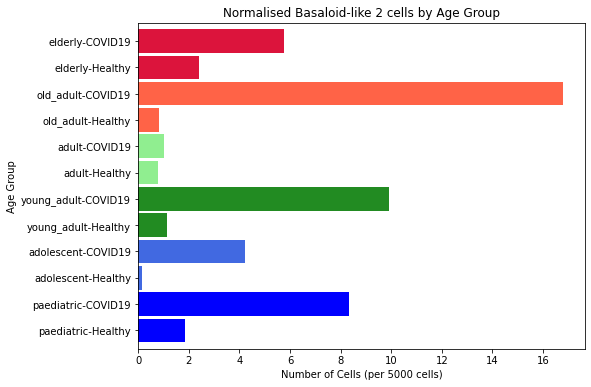

In [17]:
# Extract y-labels
y_labels = normalized_data.index

# Define the desired order of y-labels
desired_order = ['paediatric-Healthy', 'paediatric-COVID19', 'paediatric-Post-COVID', 'adolescent-Healthy', 'adolescent-COVID19',  
                'young_adult-Healthy' , 'young_adult-COVID19', 'adult-Healthy', 'adult-COVID19', 'adult-Post-COVID', 'adult-Other PF', 
                'old_adult-Healthy', 'old_adult-COVID19', 'old_adult-IPF', 'old_adult-Other PF', 'elderly-Healthy', 'elderly-COVID19', 'elderly-IPF', 'elderly-Other PF']  # Replace with your desired order

# Reorder y-labels
ordered_labels = [label for label in desired_order if label in y_labels]

# Create a list of colors corresponding to the reordered y-labels
colors = ['blue', 'blue', 'royalblue', 'royalblue', 
         'forestgreen', 'forestgreen', 'lightgreen', 'lightgreen', 
         "tomato", "tomato", "crimson", "crimson" ]  # Replace with your desired colors

# Plot stacked bar plot with reordered y-labels and colors
plt.figure(figsize=(8, 6))
normalized_data.loc[ordered_labels].plot(kind='barh', stacked=True, color=colors, width=0.9)

# Set labels and title
plt.xlabel('Number of Cells (per 5000 cells)')
plt.ylabel('Age Group')
plt.title('Normalised Basaloid-like 2 cells by Age Group')

# Remove grid lines
plt.grid(False)

# Show the plot
plt.show()

## goblet inf

In [18]:
# Subset data to include only cells from Leiden cluster 13
subset_adata = adata[adata.obs['annotation_v1'] == 'Goblet inflammatory']

In [19]:
import matplotlib.pyplot as plt

# Group the data by leiden clusters and age groups
grouped_data = subset_adata.obs.groupby(['annotation_v1', 'age_status']).size().unstack()
grouped_data

age_status,adolescent-COVID19,adolescent-Healthy,adult-COVID19,adult-Healthy,adult-Post-COVID,elderly-COVID19,elderly-Healthy,elderly-IPF,old_adult-COVID19,old_adult-Healthy,old_adult-IPF,old_adult-Other PF,paediatric-COVID19,paediatric-Healthy,paediatric-Post-COVID,young_adult-COVID19,young_adult-Healthy
annotation_v1,,,,,,,,,,,,,,,,,
Goblet inflammatory,663,169,2134,99,1,8438,126,5,777,16,9,4,4430,440,6,558,17


In [20]:
subset_adata.obs['age_status'].value_counts()

elderly-COVID19          8438
paediatric-COVID19       4430
adult-COVID19            2134
old_adult-COVID19         777
adolescent-COVID19        663
young_adult-COVID19       558
paediatric-Healthy        440
adolescent-Healthy        169
elderly-Healthy           126
adult-Healthy              99
young_adult-Healthy        17
old_adult-Healthy          16
old_adult-IPF               9
paediatric-Post-COVID       6
elderly-IPF                 5
old_adult-Other PF          4
adult-Post-COVID            1
Name: age_status, dtype: int64

In [21]:
subset_adata.obs['file_of_origin'].value_counts()

Yoshida_2022.h5ad               9738
Loske_2021.h5ad                 5515
Chua_2020.h5ad                  1479
Trump_2020.h5ad                  826
Melms_2021.h5ad                  248
Bharat_2020.h5ad                  52
Delorey_2021_COVID_only.h5ad      17
Ziegler_2021.h5ad                 17
Name: file_of_origin, dtype: int64

In [22]:
subset_adata.obs['donor_harmonised'].value_counts()

AP10            7633
BIH-c-CoV-09    1159
BIH-c-CoV-18     973
PP9              843
BIH-a-CoV-18     564
                ... 
NP47               1
BIH-SCV2-08        1
BIH-SCV2-07        1
BIH-a-Con-11       1
VUILD65            1
Name: donor_harmonised, Length: 245, dtype: int64

In [23]:
cluster_data = subset_adata.obs.groupby('age_status').size()
cluster_data.sort_values(ascending=False)

age_status
elderly-COVID19          8438
paediatric-COVID19       4430
adult-COVID19            2134
old_adult-COVID19         777
adolescent-COVID19        663
young_adult-COVID19       558
paediatric-Healthy        440
adolescent-Healthy        169
elderly-Healthy           126
adult-Healthy              99
young_adult-Healthy        17
old_adult-Healthy          16
old_adult-IPF               9
paediatric-Post-COVID       6
elderly-IPF                 5
old_adult-Other PF          4
adult-Post-COVID            1
dtype: int64

In [24]:
# Group the filtered data by age groups and count the number of cells
grouped_data = adata.obs.groupby('age_status').size()
grouped_data.sort_values(ascending=False)

age_status
elderly-COVID19          96440
paediatric-Healthy       77802
old_adult-COVID19        61588
adult-COVID19            53440
paediatric-COVID19       49909
elderly-Healthy          41541
adolescent-COVID19       41277
adult-Healthy            38322
old_adult-Healthy        37351
adolescent-Healthy       34906
young_adult-COVID19      27279
elderly-IPF              17413
young_adult-Healthy      17388
old_adult-IPF             7464
adult-Post-COVID          5038
paediatric-Post-COVID     3545
old_adult-Other PF        3325
elderly-Other PF           473
adult-Other PF             194
dtype: int64

In [120]:
# Normalize the number of cells to a total of 5000 cells per age group
normalized_data = (cluster_data / grouped_data) * 5000

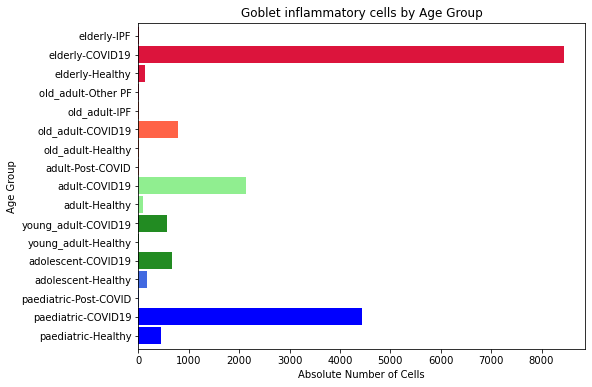

In [25]:
# Extract y-labels
y_labels = cluster_data.index

# Define the desired order of y-labels
desired_order = ['paediatric-Healthy', 'paediatric-COVID19', 'paediatric-Post-COVID', 'adolescent-Healthy', 'adolescent-COVID19',  
                'young_adult-Healthy' , 'young_adult-COVID19', 'adult-Healthy', 'adult-COVID19', 'adult-Post-COVID', 'adult-Other PF', 
                'old_adult-Healthy', 'old_adult-COVID19', 'old_adult-IPF', 'old_adult-Other PF', 'elderly-Healthy', 'elderly-COVID19', 'elderly-IPF', 'elderly-Other PF']  # Replace with your desired order

# Reorder y-labels
ordered_labels = [label for label in desired_order if label in y_labels]

# Create a list of colors corresponding to the reordered y-labels
colors = ['blue', 'blue', 'royalblue', 'royalblue', 
         'forestgreen', 'forestgreen', 'forestgreen', 'lightgreen', 'lightgreen', 
         "tomato", "tomato", "tomato", "tomato",
         "crimson", "crimson", "crimson", "crimson"]  # Replace with your desired colors

# Plot stacked bar plot with reordered y-labels and colors
plt.figure(figsize=(8, 6))
cluster_data.loc[ordered_labels].plot(kind='barh', stacked=True, color=colors, width=0.9)

# Set labels and title
plt.xlabel('Absolute Number of Cells')
plt.ylabel('Age Group')
plt.title('Goblet inflammatory cells by Age Group')

# Remove grid lines
plt.grid(False)

# Show the plot
plt.show()

In [26]:
cluster_data = cluster_data[['paediatric-Healthy', 'paediatric-COVID19', 'adolescent-Healthy', 'adolescent-COVID19',  
              'young_adult-Healthy' , 'young_adult-COVID19', 'adult-Healthy', 'adult-COVID19',
             'old_adult-Healthy', 'old_adult-COVID19', 'elderly-Healthy', 'elderly-COVID19']]

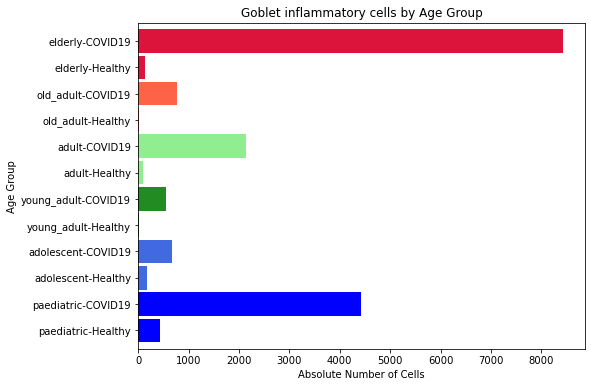

In [27]:
# Extract y-labels
y_labels = cluster_data.index

# Define the desired order of y-labels
desired_order = ['paediatric-Healthy', 'paediatric-COVID19', 'paediatric-Post-COVID', 'adolescent-Healthy', 'adolescent-COVID19',  
                'young_adult-Healthy' , 'young_adult-COVID19', 'adult-Healthy', 'adult-COVID19', 'adult-Post-COVID', 'adult-Other PF', 
                'old_adult-Healthy', 'old_adult-COVID19', 'old_adult-IPF', 'old_adult-Other PF', 'elderly-Healthy', 'elderly-COVID19', 'elderly-IPF', 'elderly-Other PF']  # Replace with your desired order

# Reorder y-labels
ordered_labels = [label for label in desired_order if label in y_labels]

# Create a list of colors corresponding to the reordered y-labels
colors = ['blue', 'blue', 'royalblue', 'royalblue', 
         'forestgreen', 'forestgreen', 'lightgreen', 'lightgreen', 
         "tomato", "tomato", "crimson", "crimson" ]  # Replace with your desired colors

# Plot stacked bar plot with reordered y-labels and colors
plt.figure(figsize=(8, 6))
cluster_data.loc[ordered_labels].plot(kind='barh', stacked=True, color=colors, width=0.9)

# Set labels and title
plt.xlabel('Absolute Number of Cells')
plt.ylabel('Age Group')
plt.title('Goblet inflammatory cells by Age Group')

# Remove grid lines
plt.grid(False)

# Show the plot
plt.show()

In [28]:
normalized_data.sort_values(ascending=False)

age_status
old_adult-COVID19      16.805222
young_adult-COVID19     9.897724
paediatric-COVID19      8.315134
elderly-COVID19         5.754873
adolescent-COVID19      4.239649
elderly-Healthy         2.407260
paediatric-Healthy      1.863705
young_adult-Healthy     1.150219
adult-COVID19           1.029192
old_adult-Healthy       0.803191
adult-Healthy           0.782840
adolescent-Healthy      0.143242
dtype: float64

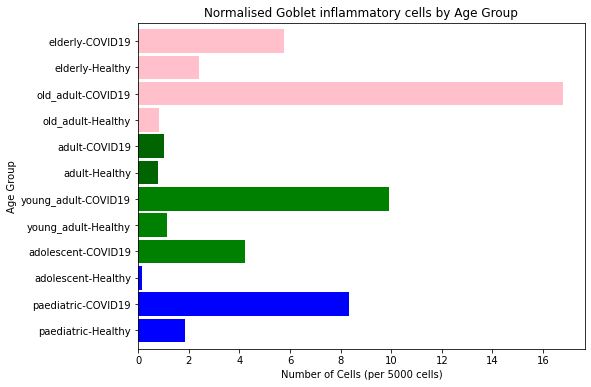

In [29]:
# Extract y-labels
y_labels = normalized_data.index

# Define the desired order of y-labels
desired_order = ['paediatric-Healthy', 'paediatric-COVID19', 'paediatric-Post-COVID',
                'adolescent-Healthy', 'adolescent-COVID19',  'young_adult-Healthy' , 'young_adult-COVID19', 
                'adult-Healthy', 'adult-COVID19', 'adult-Post-COVID', 'adult-Other PF', 
                'old_adult-Healthy', 'old_adult-COVID19', 'old_adult-IPF', 'old_adult-Other PF',
                'elderly-Healthy', 'elderly-COVID19', 'elderly-IPF', 'elderly-Other PF']  # Replace with your desired order

# Reorder y-labels
ordered_labels = [label for label in desired_order if label in y_labels]

# Create a list of colors corresponding to the reordered y-labels
colors = ['blue', 'blue', 'blue', 
         'green', 'green', 'green', 'darkgreen', 'darkgreen', 
         'pink', 'pink', 'pink', 'pink', 
         "orange", "orange", "orange", "orange",
         "red", "red", "red", "red"]  # Replace with your desired colors

# Plot stacked bar plot with reordered y-labels and colors
plt.figure(figsize=(8, 6))
normalized_data.loc[ordered_labels].plot(kind='barh', stacked=True, color=colors, width=0.9)

# Set labels and title
plt.xlabel('Number of Cells (per 5000 cells)')
plt.ylabel('Age Group')
plt.title('Normalised Goblet inflammatory cells by Age Group')

# Remove grid lines
plt.grid(False)

# Show the plot
plt.show()

In [30]:
normalized_data = normalized_data[['paediatric-Healthy', 'paediatric-COVID19', 'adolescent-Healthy', 'adolescent-COVID19',  
              'young_adult-Healthy' , 'young_adult-COVID19', 'adult-Healthy', 'adult-COVID19',
             'old_adult-Healthy', 'old_adult-COVID19', 'elderly-Healthy', 'elderly-COVID19']]

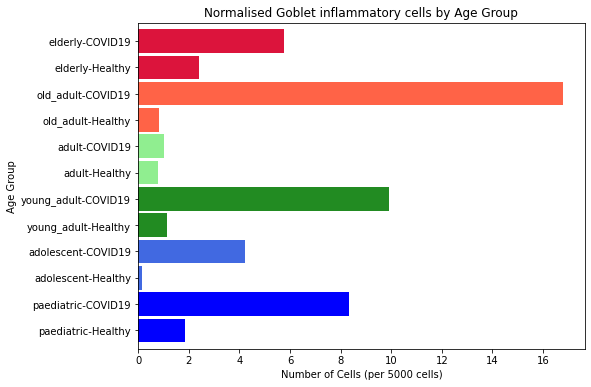

In [31]:
# Extract y-labels
y_labels = normalized_data.index

# Define the desired order of y-labels
desired_order = ['paediatric-Healthy', 'paediatric-COVID19', 'paediatric-Post-COVID', 'adolescent-Healthy', 'adolescent-COVID19',  
                'young_adult-Healthy' , 'young_adult-COVID19', 'adult-Healthy', 'adult-COVID19', 'adult-Post-COVID', 'adult-Other PF', 
                'old_adult-Healthy', 'old_adult-COVID19', 'old_adult-IPF', 'old_adult-Other PF', 'elderly-Healthy', 'elderly-COVID19', 'elderly-IPF', 'elderly-Other PF']  # Replace with your desired order

# Reorder y-labels
ordered_labels = [label for label in desired_order if label in y_labels]

# Create a list of colors corresponding to the reordered y-labels
colors = ['blue', 'blue', 'royalblue', 'royalblue', 
         'forestgreen', 'forestgreen', 'lightgreen', 'lightgreen', 
         "tomato", "tomato", "crimson", "crimson" ]  # Replace with your desired colors

# Plot stacked bar plot with reordered y-labels and colors
plt.figure(figsize=(8, 6))
normalized_data.loc[ordered_labels].plot(kind='barh', stacked=True, color=colors, width=0.9)

# Set labels and title
plt.xlabel('Number of Cells (per 5000 cells)')
plt.ylabel('Age Group')
plt.title('Normalised Goblet inflammatory cells by Age Group')

# Remove grid lines
plt.grid(False)

# Show the plot
plt.show()

# make age_status more coarse

In [32]:
adata.obs['age_status_granular'] = adata.obs['age_status']

In [33]:
import pandas as pd

# Replace the category
adata.obs['age_status'] = pd.Series(adata.obs['age_status']).replace('adolescent-COVID19', 'paediatric-COVID19')
adata.obs['age_status'] = pd.Series(adata.obs['age_status']).replace('adolescent-Healthy', 'paediatric-Healthy')
adata.obs['age_status'] = pd.Series(adata.obs['age_status']).replace('old_adult-COVID19', 'elderly-COVID19')
adata.obs['age_status'] = pd.Series(adata.obs['age_status']).replace('old_adult-Healthy', 'elderly-Healthy')
adata.obs['age_status'] = pd.Series(adata.obs['age_status']).replace('old_adult-IPF', 'elderly-IPF')
adata.obs['age_status'] = pd.Series(adata.obs['age_status']).replace('old_adult-Other PF', 'elderly-Other PF')
adata.obs['age_status'] = pd.Series(adata.obs['age_status']).replace('young_adult-COVID19', 'adult-COVID19')
adata.obs['age_status'] = pd.Series(adata.obs['age_status']).replace('young_adult-Healthy', 'adult-Healthy')

In [34]:
np.unique(adata.obs['age_status'])

array(['adult-COVID19', 'adult-Healthy', 'adult-Other PF',
       'adult-Post-COVID', 'elderly-COVID19', 'elderly-Healthy',
       'elderly-IPF', 'elderly-Other PF', 'paediatric-COVID19',
       'paediatric-Healthy', 'paediatric-Post-COVID'], dtype=object)

## basaloid

In [82]:
# Subset data to include only cells from Leiden cluster 13
subset_adata = adata[adata.obs['annotation_v1'] == 'Basaloid-like 2']

In [83]:
import matplotlib.pyplot as plt

# Group the data by leiden clusters and age groups
grouped_data = subset_adata.obs.groupby(['annotation_v1', 'age_status']).size().unstack()
grouped_data

age_status,adult-COVID19,adult-Healthy,adult-Other PF,elderly-COVID19,elderly-Healthy,elderly-IPF,elderly-Other PF,paediatric-COVID19,paediatric-Healthy
annotation_v1,,,,,,,,,
Basaloid-like 2,65,10,1,318,26,354,81,118,30


In [84]:
subset_adata.obs['age_status'].value_counts()

elderly-IPF           354
elderly-COVID19       318
paediatric-COVID19    118
elderly-Other PF       81
adult-COVID19          65
paediatric-Healthy     30
elderly-Healthy        26
adult-Healthy          10
adult-Other PF          1
Name: age_status, dtype: int64

In [85]:
subset_adata.obs['file_of_origin'].value_counts()

Bharat_2020.h5ad                695
Yoshida_2022.h5ad               132
Melms_2021.h5ad                 121
Loske_2021.h5ad                  21
Ziegler_2021.h5ad                13
Delorey_2021_COVID_only.h5ad     12
Chua_2020.h5ad                    5
Trump_2020.h5ad                   4
Name: file_of_origin, dtype: int64

In [86]:
subset_adata.obs['donor_harmonised'].value_counts()

PB 1            184
VUILD64         115
VUILD60          99
VUILD59          87
TX_Recipient     53
               ... 
NP37              1
NP39              1
D7                1
PP2               1
AP11              1
Name: donor_harmonised, Length: 103, dtype: int64

In [87]:
cluster_data = subset_adata.obs.groupby('age_status').size()
cluster_data.sort_values(ascending=False)

age_status
elderly-IPF           354
elderly-COVID19       318
paediatric-COVID19    118
elderly-Other PF       81
adult-COVID19          65
paediatric-Healthy     30
elderly-Healthy        26
adult-Healthy          10
adult-Other PF          1
dtype: int64

In [91]:
cluster_data

age_status
adult-COVID19          65
adult-Healthy          10
adult-Other PF          1
elderly-COVID19       318
elderly-Healthy        26
elderly-IPF           354
elderly-Other PF       81
paediatric-COVID19    118
paediatric-Healthy     30
dtype: int64

In [88]:
# Group the filtered data by age groups and count the number of cells
grouped_data = adata.obs.groupby('age_status').size()
grouped_data.sort_values(ascending=False)

age_status
elderly-COVID19          158028
paediatric-Healthy       112708
paediatric-COVID19        91186
adult-COVID19             80719
elderly-Healthy           78892
adult-Healthy             55710
elderly-IPF               24877
adult-Post-COVID           5038
elderly-Other PF           3798
paediatric-Post-COVID      3545
adult-Other PF              194
dtype: int64

In [89]:
# Normalize the number of cells to a total of 5000 cells per age group
normalized_data = (cluster_data / grouped_data) * 5000

In [90]:
normalized_data

age_status
adult-COVID19              4.026314
adult-Healthy              0.897505
adult-Other PF            25.773196
adult-Post-COVID                NaN
elderly-COVID19           10.061508
elderly-Healthy            1.647822
elderly-IPF               71.150058
elderly-Other PF         106.635071
paediatric-COVID19         6.470291
paediatric-Healthy         1.330873
paediatric-Post-COVID           NaN
dtype: float64

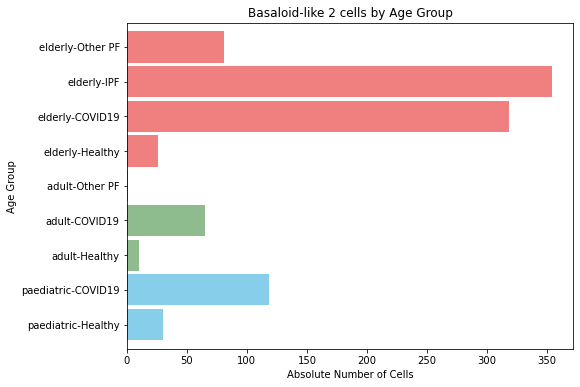

In [43]:
# Extract y-labels
y_labels = cluster_data.index

# Define the desired order of y-labels
desired_order = ['paediatric-Healthy', 'paediatric-COVID19', 'paediatric-Post-COVID', 'adolescent-Healthy', 'adolescent-COVID19',  
                'young_adult-Healthy' , 'young_adult-COVID19', 'adult-Healthy', 'adult-COVID19', 'adult-Post-COVID', 'adult-Other PF', 
                'old_adult-Healthy', 'old_adult-COVID19', 'old_adult-IPF', 'old_adult-Other PF', 'elderly-Healthy', 'elderly-COVID19', 'elderly-IPF', 'elderly-Other PF']  # Replace with your desired order

# Reorder y-labels
ordered_labels = [label for label in desired_order if label in y_labels]

# Create a list of colors corresponding to the reordered y-labels
colors = ['skyblue', 'skyblue', 
         'darkseagreen', 'darkseagreen', 'darkseagreen', 
         "lightcoral", "lightcoral", "lightcoral", "lightcoral"]  # Replace with your desired colors

# Plot stacked bar plot with reordered y-labels and colors
plt.figure(figsize=(8, 6))
cluster_data.loc[ordered_labels].plot(kind='barh', stacked=True, color=colors, width=0.9)

# Set labels and title
plt.xlabel('Absolute Number of Cells')
plt.ylabel('Age Group')
plt.title('Basaloid-like 2 cells by Age Group')

# Remove grid lines
plt.grid(False)

# Show the plot
plt.show()

In [44]:
cluster_data = cluster_data[['paediatric-Healthy', 'paediatric-COVID19','adult-Healthy', 'adult-COVID19', 'elderly-Healthy', 'elderly-COVID19']]

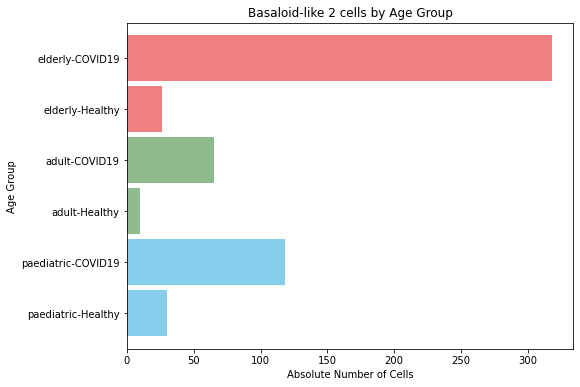

In [45]:
# Extract y-labels
y_labels = cluster_data.index

# Define the desired order of y-labels
desired_order = ['paediatric-Healthy', 'paediatric-COVID19','adult-Healthy', 'adult-COVID19', 'elderly-Healthy', 'elderly-COVID19']  # Replace with your desired order

# Reorder y-labels
ordered_labels = [label for label in desired_order if label in y_labels]

# Create a list of colors corresponding to the reordered y-labels
colors = ['skyblue', 'skyblue',
         'darkseagreen', 'darkseagreen', 
         "lightcoral", "lightcoral" ]  # Replace with your desired colors

# Plot stacked bar plot with reordered y-labels and colors
plt.figure(figsize=(8, 6))
cluster_data.loc[ordered_labels].plot(kind='barh', stacked=True, color=colors, width=0.9)

# Set labels and title
plt.xlabel('Absolute Number of Cells')
plt.ylabel('Age Group')
plt.title('Basaloid-like 2 cells by Age Group')

# Remove grid lines
plt.grid(False)

# Show the plot
plt.show()

In [46]:
normalized_data.sort_values(ascending=False)

age_status
elderly-Other PF         106.635071
elderly-IPF               71.150058
adult-Other PF            25.773196
elderly-COVID19           10.061508
paediatric-COVID19         6.470291
adult-COVID19              4.026314
elderly-Healthy            1.647822
paediatric-Healthy         1.330873
adult-Healthy              0.897505
adult-Post-COVID                NaN
paediatric-Post-COVID           NaN
dtype: float64

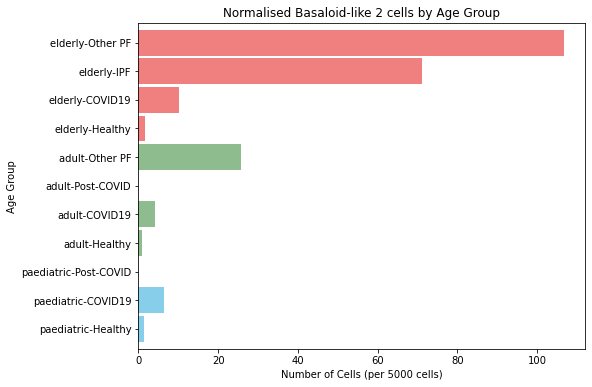

In [47]:
# Extract y-labels
y_labels = normalized_data.index

# Define the desired order of y-labels
desired_order = ['paediatric-Healthy', 'paediatric-COVID19', 'paediatric-Post-COVID', 'adolescent-Healthy', 'adolescent-COVID19',  
                'young_adult-Healthy' , 'young_adult-COVID19', 'adult-Healthy', 'adult-COVID19', 'adult-Post-COVID', 'adult-Other PF', 
                'old_adult-Healthy', 'old_adult-COVID19', 'old_adult-IPF', 'old_adult-Other PF', 'elderly-Healthy', 'elderly-COVID19', 'elderly-IPF', 'elderly-Other PF']  # Replace with your desired order

# Reorder y-labels
ordered_labels = [label for label in desired_order if label in y_labels]

# Create a list of colors corresponding to the reordered y-labels
colors = ['skyblue', 'skyblue', 'skyblue', 
         'darkseagreen', 'darkseagreen', 'darkseagreen', 'darkseagreen', 
         "lightcoral", "lightcoral", "lightcoral", "lightcoral"]  # Replace with your desired colors

# Plot stacked bar plot with reordered y-labels and colors
plt.figure(figsize=(8, 6))
normalized_data.loc[ordered_labels].plot(kind='barh', stacked=True, color=colors, width=0.9)

# Set labels and title
plt.xlabel('Number of Cells (per 5000 cells)')
plt.ylabel('Age Group')
plt.title('Normalised Basaloid-like 2 cells by Age Group')

# Remove grid lines
plt.grid(False)

# Show the plot
plt.show()

In [48]:
normalized_data = normalized_data[['paediatric-Healthy', 'paediatric-COVID19','adult-Healthy', 'adult-COVID19', 'elderly-Healthy', 'elderly-COVID19']]

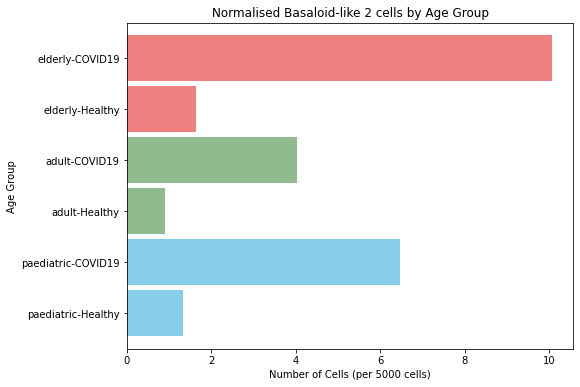

In [49]:
# Extract y-labels
y_labels = normalized_data.index

# Define the desired order of y-labels
desired_order = ['paediatric-Healthy', 'paediatric-COVID19','adult-Healthy', 'adult-COVID19', 'elderly-Healthy', 'elderly-COVID19']  # Replace with your desired order

# Reorder y-labels
ordered_labels = [label for label in desired_order if label in y_labels]

# Create a list of colors corresponding to the reordered y-labels
colors = ['skyblue', 'skyblue',
         'darkseagreen', 'darkseagreen', 
         "lightcoral", "lightcoral" ]  # Replace with your desired colors

# Plot stacked bar plot with reordered y-labels and colors
plt.figure(figsize=(8, 6))
normalized_data.loc[ordered_labels].plot(kind='barh', stacked=True, color=colors, width=0.9)

# Set labels and title
plt.xlabel('Number of Cells (per 5000 cells)')
plt.ylabel('Age Group')
plt.title('Normalised Basaloid-like 2 cells by Age Group')

# Remove grid lines
plt.grid(False)

# Show the plot
plt.show()

## goblet

In [65]:
adata

AnnData object with n_obs × n_vars = 614695 × 17591
    obs: 'n_genes', 'n_UMI', 'percent_mito', 'method', 'doublet', 'predicted_celltype', 'compartment', 'Cluster', 'SubCluster', 'Viral+', 'leiden_res_2', 'leiden_res_1.3', 'donor', 'disease', 'age', 'age_group', 'status', 'age_status', 'file_of_origin', 'sample_id', 'Sex', 'Age_bin', 'Group', 'Ethnicity_inferred', 'Smoker', 'COVID_status', 'COVID_severity', 'First_symptoms_hospitalisation_interval', 'First_symptoms_collection_interval', 'Positive_test_collection_interval', 'Sample_location', 'Kit_version', 'dataset', 'Sanger_sample_ID', 'Cell_type_annotation_level3', 'Cell_type_annotation_level1', 'Cell_type_annotation_level2', 'log1p_n_counts', 'log1p_n_genes', 'percent_ribo', 'n_counts_total_sarscov2', 'percent_total_sarscov2', 'n_counts_sarscov2', 'percent_sarscov2', 'scrublet_score', 'donor_id', 'Age', 'Peak_Respiratory_Support_WHO_Score', 'Bloody_Swab', 'Percent_Mitochondrial', 'SARSCoV2_PCR_Status', 'SARSCoV2_PCR_Status_and_WHO_

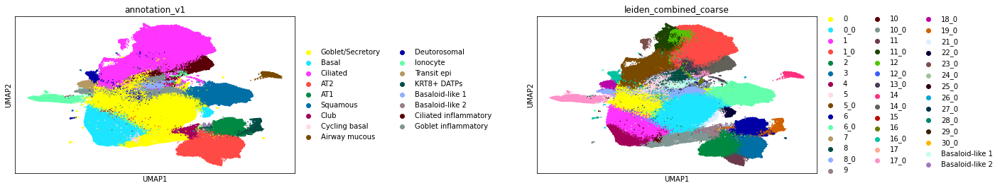

In [66]:
sc.pl.umap(adata, color = ['annotation_v1', 'leiden_combined_coarse'], wspace = 0.7, size = 10)

In [67]:
# Subset data to include only cells from Leiden cluster 13
subset_adata = adata[adata.obs['annotation_v1'] == 'Goblet inflammatory']

In [68]:
import matplotlib.pyplot as plt

# Group the data by leiden clusters and age groups
grouped_data = subset_adata.obs.groupby(['annotation_v1', 'age_status_granular']).size().unstack()
grouped_data

age_status_granular,adolescent-COVID19,adolescent-Healthy,adult-COVID19,adult-Healthy,adult-Post-COVID,elderly-COVID19,elderly-Healthy,elderly-IPF,old_adult-COVID19,old_adult-Healthy,old_adult-IPF,old_adult-Other PF,paediatric-COVID19,paediatric-Healthy,paediatric-Post-COVID,young_adult-COVID19,young_adult-Healthy
annotation_v1,,,,,,,,,,,,,,,,,
Goblet inflammatory,663,169,2134,99,1,8438,126,5,777,16,9,4,4430,440,6,558,17


In [69]:
subset_adata.obs['age_status'].value_counts()

elderly-COVID19          9215
paediatric-COVID19       5093
adult-COVID19            2692
paediatric-Healthy        609
elderly-Healthy           142
adult-Healthy             116
elderly-IPF                14
paediatric-Post-COVID       6
elderly-Other PF            4
adult-Post-COVID            1
Name: age_status, dtype: int64

In [70]:
subset_adata.obs['file_of_origin'].value_counts()

Yoshida_2022.h5ad               9738
Loske_2021.h5ad                 5515
Chua_2020.h5ad                  1479
Trump_2020.h5ad                  826
Melms_2021.h5ad                  248
Bharat_2020.h5ad                  52
Delorey_2021_COVID_only.h5ad      17
Ziegler_2021.h5ad                 17
Name: file_of_origin, dtype: int64

In [71]:
subset_adata.obs['donor_harmonised'].value_counts()

AP10            7633
BIH-c-CoV-09    1159
BIH-c-CoV-18     973
PP9              843
BIH-a-CoV-18     564
                ... 
NP47               1
BIH-SCV2-08        1
BIH-SCV2-07        1
BIH-a-Con-11       1
VUILD65            1
Name: donor_harmonised, Length: 245, dtype: int64

In [72]:
cluster_data = subset_adata.obs.groupby('age_status').size()
cluster_data.sort_values(ascending=False)

age_status
elderly-COVID19          9215
paediatric-COVID19       5093
adult-COVID19            2692
paediatric-Healthy        609
elderly-Healthy           142
adult-Healthy             116
elderly-IPF                14
paediatric-Post-COVID       6
elderly-Other PF            4
adult-Post-COVID            1
dtype: int64

In [73]:
# Group the filtered data by age groups and count the number of cells
grouped_data = adata.obs.groupby('age_status').size()
grouped_data.sort_values(ascending=False)

age_status
elderly-COVID19          158028
paediatric-Healthy       112708
paediatric-COVID19        91186
adult-COVID19             80719
elderly-Healthy           78892
adult-Healthy             55710
elderly-IPF               24877
adult-Post-COVID           5038
elderly-Other PF           3798
paediatric-Post-COVID      3545
adult-Other PF              194
dtype: int64

In [74]:
# Normalize the number of cells to a total of 5000 cells per age group
normalized_data = (cluster_data / grouped_data) * 5000

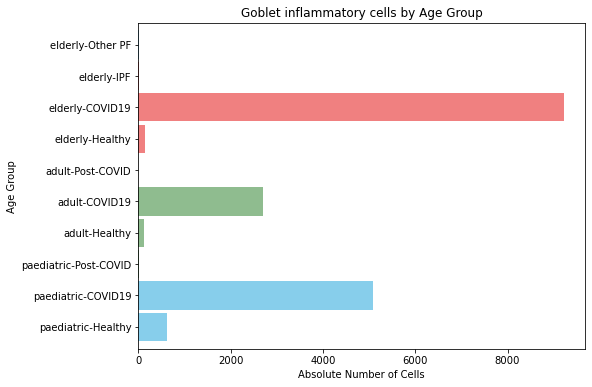

In [75]:
# Extract y-labels
y_labels = cluster_data.index

# Define the desired order of y-labels
desired_order = ['paediatric-Healthy', 'paediatric-COVID19', 'paediatric-Post-COVID', 'adolescent-Healthy', 'adolescent-COVID19',  
                'young_adult-Healthy' , 'young_adult-COVID19', 'adult-Healthy', 'adult-COVID19', 'adult-Post-COVID', 'adult-Other PF', 
                'old_adult-Healthy', 'old_adult-COVID19', 'old_adult-IPF', 'old_adult-Other PF', 'elderly-Healthy', 'elderly-COVID19', 'elderly-IPF', 'elderly-Other PF']  # Replace with your desired order

# Reorder y-labels
ordered_labels = [label for label in desired_order if label in y_labels]

# Create a list of colors corresponding to the reordered y-labels
colors = ['skyblue', 'skyblue', 
         'darkseagreen', 'darkseagreen', 'darkseagreen', 
         "lightcoral", "lightcoral", "lightcoral", "lightcoral"]  # Replace with your desired colors

# Plot stacked bar plot with reordered y-labels and colors
plt.figure(figsize=(8, 6))
cluster_data.loc[ordered_labels].plot(kind='barh', stacked=True, color=colors, width=0.9)

# Set labels and title
plt.xlabel('Absolute Number of Cells')
plt.ylabel('Age Group')
plt.title('Goblet inflammatory cells by Age Group')

# Remove grid lines
plt.grid(False)

# Show the plot
plt.show()

In [76]:
cluster_data = cluster_data[['paediatric-Healthy', 'paediatric-COVID19','adult-Healthy', 'adult-COVID19', 'elderly-Healthy', 'elderly-COVID19']]

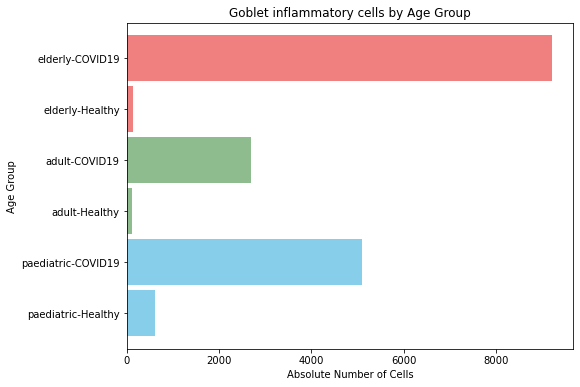

In [77]:
# Extract y-labels
y_labels = cluster_data.index

# Define the desired order of y-labels
desired_order = ['paediatric-Healthy', 'paediatric-COVID19','adult-Healthy', 'adult-COVID19', 'elderly-Healthy', 'elderly-COVID19']  # Replace with your desired order

# Reorder y-labels
ordered_labels = [label for label in desired_order if label in y_labels]

# Create a list of colors corresponding to the reordered y-labels
colors = ['skyblue', 'skyblue',
         'darkseagreen', 'darkseagreen', 
         "lightcoral", "lightcoral" ]  # Replace with your desired colors

# Plot stacked bar plot with reordered y-labels and colors
plt.figure(figsize=(8, 6))
cluster_data.loc[ordered_labels].plot(kind='barh', stacked=True, color=colors, width=0.9)

# Set labels and title
plt.xlabel('Absolute Number of Cells')
plt.ylabel('Age Group')
plt.title('Goblet inflammatory cells by Age Group')

# Remove grid lines
plt.grid(False)

# Show the plot
plt.show()

In [78]:
normalized_data.sort_values(ascending=False)

age_status
elderly-COVID19          291.562255
paediatric-COVID19       279.264361
adult-COVID19            166.751322
paediatric-Healthy        27.016716
adult-Healthy             10.411057
elderly-Healthy            8.999645
paediatric-Post-COVID      8.462623
elderly-Other PF           5.265929
elderly-IPF                2.813844
adult-Post-COVID           0.992457
adult-Other PF                  NaN
dtype: float64

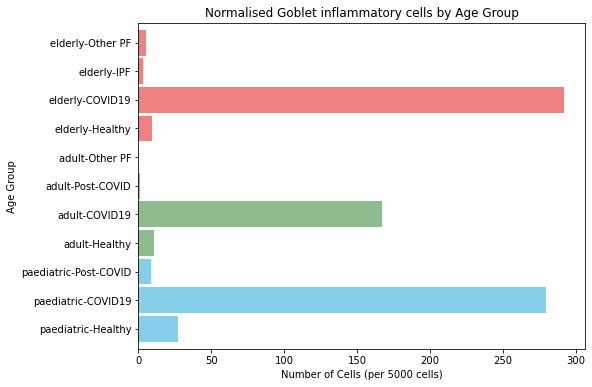

In [79]:
# Extract y-labels
y_labels = normalized_data.index

# Define the desired order of y-labels
desired_order = ['paediatric-Healthy', 'paediatric-COVID19', 'paediatric-Post-COVID', 'adolescent-Healthy', 'adolescent-COVID19',  
                'young_adult-Healthy' , 'young_adult-COVID19', 'adult-Healthy', 'adult-COVID19', 'adult-Post-COVID', 'adult-Other PF', 
                'old_adult-Healthy', 'old_adult-COVID19', 'old_adult-IPF', 'old_adult-Other PF', 'elderly-Healthy', 'elderly-COVID19', 'elderly-IPF', 'elderly-Other PF']  # Replace with your desired order

# Reorder y-labels
ordered_labels = [label for label in desired_order if label in y_labels]

# Create a list of colors corresponding to the reordered y-labels
colors = ['skyblue', 'skyblue', 'skyblue', 
         'darkseagreen', 'darkseagreen', 'darkseagreen', 'darkseagreen', 
         "lightcoral", "lightcoral", "lightcoral", "lightcoral"]  # Replace with your desired colors

# Plot stacked bar plot with reordered y-labels and colors
plt.figure(figsize=(8, 6))
normalized_data.loc[ordered_labels].plot(kind='barh', stacked=True, color=colors, width=0.9)

# Set labels and title
plt.xlabel('Number of Cells (per 5000 cells)')
plt.ylabel('Age Group')
plt.title('Normalised Goblet inflammatory cells by Age Group')

# Remove grid lines
plt.grid(False)

# Show the plot
plt.show()

In [80]:
normalized_data = normalized_data[['paediatric-Healthy', 'paediatric-COVID19','adult-Healthy', 'adult-COVID19', 'elderly-Healthy', 'elderly-COVID19']]

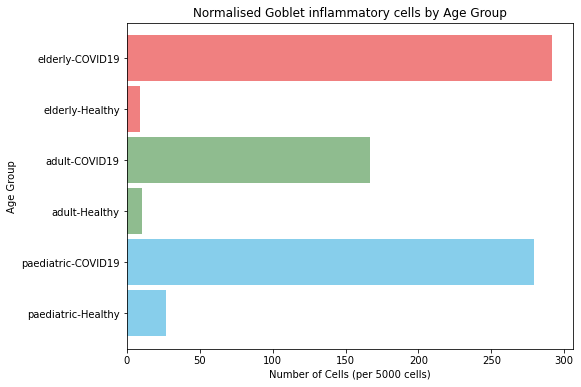

In [81]:
# Extract y-labels
y_labels = normalized_data.index

# Define the desired order of y-labels
desired_order = ['paediatric-Healthy', 'paediatric-COVID19','adult-Healthy', 'adult-COVID19', 'elderly-Healthy', 'elderly-COVID19']  # Replace with your desired order

# Reorder y-labels
ordered_labels = [label for label in desired_order if label in y_labels]

# Create a list of colors corresponding to the reordered y-labels
colors = ['skyblue', 'skyblue',
         'darkseagreen', 'darkseagreen', 
         "lightcoral", "lightcoral" ]  # Replace with your desired colors

# Plot stacked bar plot with reordered y-labels and colors
plt.figure(figsize=(8, 6))
normalized_data.loc[ordered_labels].plot(kind='barh', stacked=True, color=colors, width=0.9)

# Set labels and title
plt.xlabel('Number of Cells (per 5000 cells)')
plt.ylabel('Age Group')
plt.title('Normalised Goblet inflammatory cells by Age Group')

# Remove grid lines
plt.grid(False)

# Show the plot
plt.show()

In [70]:
adata.write('/nfs/team205/ac65/ALI_COVID19/datasets_integration_ALI/harmony_final_object_annv1_goblet_good.h5ad')

# start from here with annotated basaloid and goblet cells 

In [73]:
adata

AnnData object with n_obs × n_vars = 614695 × 17591
    obs: 'n_genes', 'n_UMI', 'percent_mito', 'method', 'doublet', 'predicted_celltype', 'compartment', 'Cluster', 'SubCluster', 'Viral+', 'leiden_res_2', 'leiden_res_1.3', 'donor', 'disease', 'age', 'age_group', 'status', 'age_status', 'file_of_origin', 'sample_id', 'Sex', 'Age_bin', 'Group', 'Ethnicity_inferred', 'Smoker', 'COVID_status', 'COVID_severity', 'First_symptoms_hospitalisation_interval', 'First_symptoms_collection_interval', 'Positive_test_collection_interval', 'Sample_location', 'Kit_version', 'dataset', 'Sanger_sample_ID', 'Cell_type_annotation_level3', 'Cell_type_annotation_level1', 'Cell_type_annotation_level2', 'log1p_n_counts', 'log1p_n_genes', 'percent_ribo', 'n_counts_total_sarscov2', 'percent_total_sarscov2', 'n_counts_sarscov2', 'percent_sarscov2', 'scrublet_score', 'donor_id', 'Age', 'Peak_Respiratory_Support_WHO_Score', 'Bloody_Swab', 'Percent_Mitochondrial', 'SARSCoV2_PCR_Status', 'SARSCoV2_PCR_Status_and_WHO_

In [74]:
np.unique(adata.obs.annotation_v1)

array(['AT1', 'AT2', 'Airway mucous', 'Basal', 'Basaloid-like 1',
       'Basaloid-like 2', 'Ciliated', 'Ciliated inflammatory', 'Club',
       'Cycling basal', 'Deutorosomal', 'Goblet inflammatory',
       'Goblet/Secretory', 'Ionocyte', 'KRT8+ DATPs', 'Squamous',
       'Transit epi'], dtype=object)

In [75]:
adata.obs

,n_genes,n_UMI,percent_mito,method,doublet,predicted_celltype,compartment,Cluster,SubCluster,Viral+,...,leiden_subset_basaloid,leiden_combined_coarse,score_IFN_alpha,score_IFN_gamma,score_EMT,score_BASALOID,annotation_v1,leiden_inflammatory,leiden_all,age_status_granular
Delorey_2021_COVID_only.h5ad:02-P005175-S053-R01-AATCACGAGGGTCACA,5933.0,20074.0,4.234333,nuclei,False,AT1,epithelial,Epithelial,Secretory,False,...,nan,2,-0.077939,0.068120,0.157006,0.418843,AT2,nan,2,old_adult-COVID19
Delorey_2021_COVID_only.h5ad:02-P005175-S053-R01-GGTAACTAGTCCTACA,5885.0,18396.0,3.169167,nuclei,False,AT1,epithelial,Epithelial,AT1,False,...,nan,6,0.024214,0.111761,0.179795,0.310751,AT1,nan,6,old_adult-COVID19
Delorey_2021_COVID_only.h5ad:02-P005175-S053-R01-CATCCGTTCGCAAGAG,5818.0,17849.0,2.213009,nuclei,False,AT1,epithelial,Epithelial,KRT8+ PATS/ADI/DATPs,False,...,nan,2,-0.038762,0.155381,0.258357,0.716596,AT2,nan,2,old_adult-COVID19
Delorey_2021_COVID_only.h5ad:02-P005175-S053-R01-TTCGGTCAGCTTTCCC,5513.0,17486.0,10.808647,nuclei,False,AT1,epithelial,Epithelial,KRT8+ PATS/ADI/DATPs,False,...,nan,2,0.296413,0.208366,0.236939,0.714845,AT2,nan,2,old_adult-COVID19
Delorey_2021_COVID_only.h5ad:02-P005175-S053-R01-TTAGGCATCCTCACTG,5774.0,16099.0,6.776818,nuclei,False,AT1,epithelial,Epithelial,Secretory,False,...,nan,2,0.139501,0.097040,0.138514,0.361797,AT2,nan,2,old_adult-COVID19
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Melms_2021.h5ad:AGCTTCCAGGCATGCA-1_27,NaN,NaN,NaN,NaN,nan,NaN,NaN,NaN,nan,nan,...,nan,2,-0.078560,0.026703,0.227514,-0.100314,AT2,nan,2,old_adult-COVID19
Melms_2021.h5ad:GCACGGTCAGAAGTTA-1_27,NaN,NaN,NaN,NaN,nan,NaN,NaN,NaN,nan,nan,...,nan,0_0,0.279772,0.033921,-0.060741,-0.086155,Goblet/Secretory,nan,0_0,old_adult-COVID19
Melms_2021.h5ad:TTGTGGATCATAGGCT-1_27,NaN,NaN,NaN,NaN,nan,NaN,NaN,NaN,nan,nan,...,nan,2,-0.066474,0.053662,-0.058798,-0.056902,AT2,nan,2,old_adult-COVID19
Melms_2021.h5ad:GCCGATGAGTAAACGT-1_27,NaN,NaN,NaN,NaN,nan,NaN,NaN,NaN,nan,nan,...,nan,0,-0.090820,0.002190,0.127114,0.035694,Goblet/Secretory,nan,0,old_adult-COVID19


In [165]:
adata.obs['annotation_v1'].cat.reorder_categories(['Basal', 'Cycling basal', 'Basaloid-like 2',
       'Basaloid-like 1', 'Goblet/Secretory', 'Goblet inflammatory', 'Club', 'Transit epi', 'Ciliated',
       'Ciliated inflammatory', 'Deutorosomal', 'Ionocyte', 'Squamous', 'AT1', 'AT2', 'KRT8+ DATPs', 'Airway mucous'], inplace=True)

In [166]:
import matplotlib
matplotlib.rcParams.update({'font.size': 18})

In [98]:
marker_genes_dict_2 = {'Basal': ['KRT5', 'KRT17', 'KRT14','KRT15', 'DLK2', 'TP63', 'DAPL1', 'NOTCH1', 'NOTCH3'],
                     'EMT': ['CDH2', 'VIM', 'FN1', 'COL1A1', 'COL3A1', 'LAMA5', 'ITGB6', 'MMP7'], 
                     'Cycling basal': ['MKI67', 'NUSAP1'],
                     'Goblet': ['TFF3','MUC5AC','BPIFA1', 'BPIFA2','MUC5B','TFF1', 'PLAU'], 
                     'Secretory': ['NOS2', 'CAPN13', 'RARRES1', 'SERPINB3', 'AQP5', 'CP', 'PI3'],
                      'Goblet inflammatory': ['CXCL10', 'OAS1', 'IFIT1', 'IFIT3'],  
                     'Club': ['SCGB1A1', 'SCGB3A1'],  
                     'Infected': ['ACE2', 'TMPRSS2'],
                     'Ciliated 1': ['OMG', 'PIFO', 'FOXJ1'], 
                     'Ciliated 2': ['CCDC40'],
                     'Deutorosomal': ['FOXN4', 'CDC20B'], 
                     'Ionocyte': ['FOXI1'], 
                     'Squamous': [ "KRT78"], 
                     'AT1': ['RTKN2', 'CLIC5'], 
                     'AT2': ['SFTPA1', 'SFTPA2', 'WIF1', 'HHIP', 'CA2', 'ETV5'], 
                     'KRT8+': ['KRT8', 'TP53']
                     }

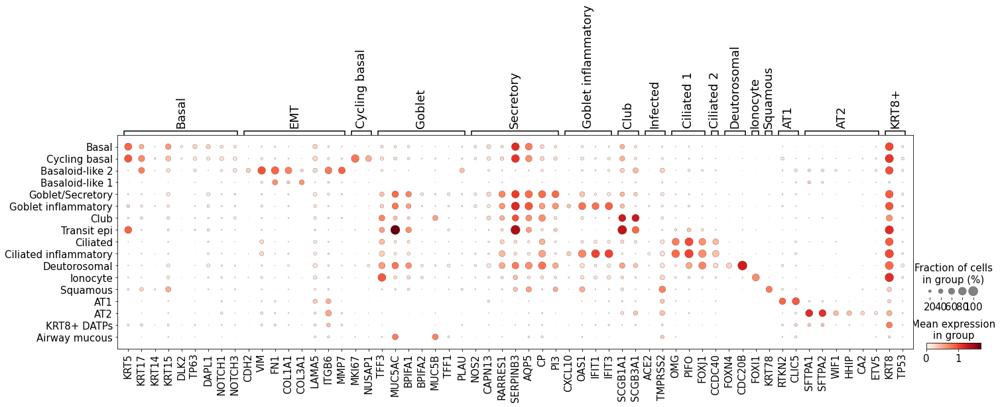

In [168]:
sc.pl.dotplot(adata, marker_genes_dict_2, groupby='annotation_v1', log = True)

In [169]:
marker_genes_dict_3 = ['KRT5', 'KRT17', 'KRT14','KRT15', 'DLK2', 'TP63', 'DAPL1', 'NOTCH1', 'NOTCH3',
                     'CDH2', 'VIM', 'FN1', 'COL1A1', 'COL3A1', 'LAMA5', 'ITGB6', 'MMP7', 
                     'MKI67', 'NUSAP1',
                     'TFF3','MUC5AC','BPIFA1', 'BPIFA2','MUC5B','TFF1', 'PLAU', 
                     'NOS2', 'CAPN13', 'RARRES1', 'SERPINB3', 'AQP5', 'CP', 'PI3',
                      'CXCL10', 'OAS1', 'IFIT1', 'IFIT3',  
                     'SCGB1A1', 'SCGB3A1',  
                     'ACE2', 'TMPRSS2',
                     'OMG', 'PIFO', 'FOXJ1', 
                     'CCDC40',
                     'FOXN4', 'CDC20B', 
                      'FOXI1', 
                      "KRT78", 
                      'RTKN2', 'CLIC5', 
                     'SFTPA1', 'SFTPA2', 'WIF1', 'HHIP', 'CA2', 'ETV5', 
                     'KRT8', 'TP53']

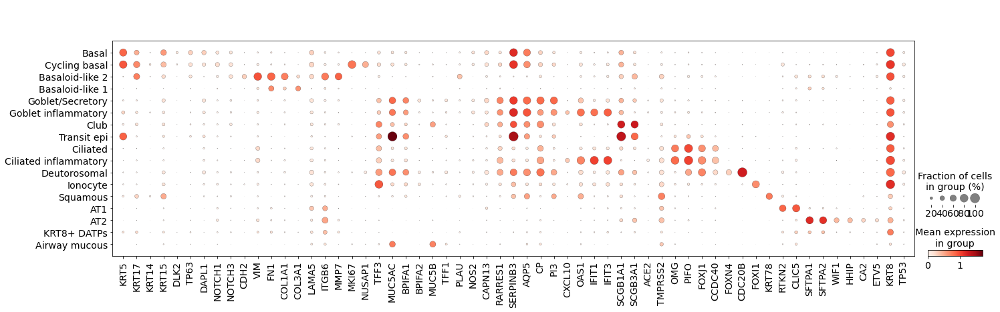

In [171]:
import matplotlib
matplotlib.rcParams.update({'font.size': 17})
sc.pl.dotplot(adata, marker_genes_dict_3, groupby='annotation_v1', log = True)

In [172]:
adata

AnnData object with n_obs × n_vars = 614695 × 17591
    obs: 'n_genes', 'n_UMI', 'percent_mito', 'method', 'doublet', 'predicted_celltype', 'compartment', 'Cluster', 'SubCluster', 'Viral+', 'leiden_res_2', 'leiden_res_1.3', 'donor', 'disease', 'age', 'age_group', 'status', 'age_status', 'file_of_origin', 'sample_id', 'Sex', 'Age_bin', 'Group', 'Ethnicity_inferred', 'Smoker', 'COVID_status', 'COVID_severity', 'First_symptoms_hospitalisation_interval', 'First_symptoms_collection_interval', 'Positive_test_collection_interval', 'Sample_location', 'Kit_version', 'dataset', 'Sanger_sample_ID', 'Cell_type_annotation_level3', 'Cell_type_annotation_level1', 'Cell_type_annotation_level2', 'log1p_n_counts', 'log1p_n_genes', 'percent_ribo', 'n_counts_total_sarscov2', 'percent_total_sarscov2', 'n_counts_sarscov2', 'percent_sarscov2', 'scrublet_score', 'donor_id', 'Age', 'Peak_Respiratory_Support_WHO_Score', 'Bloody_Swab', 'Percent_Mitochondrial', 'SARSCoV2_PCR_Status', 'SARSCoV2_PCR_Status_and_WHO_

In [211]:
yourcolors = {'Basal': "thistle", 
              'Basaloid-like 1':"indigo",
              'Basaloid-like 2':"crimson",
              'Cycling basal':"maroon", 
              'Goblet/Secretory':"#bb7693",
              'Goblet inflammatory':"royalblue", 
              'Club':"#20B2AA",  
              'Transit epi':"#849db1", 
              'Ciliated':"teal", 
              'Ciliated inflammatory':"#3ca8bc",
              'Deutorosomal':"#DB7202", 
              'Ionocyte':"#c3bc3f", 
              'Squamous':"#4e9f50", 
              'AT1':"darkorange", 
              'AT2':"#f7d42a", 
              'KRT8+ DATPs':"#AF894B",
             'Airway mucous': 'grey'}

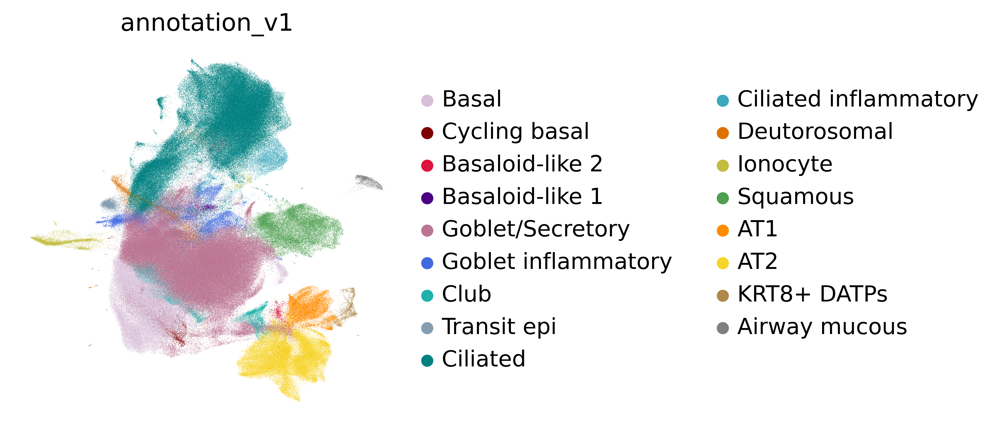

In [212]:
sc.settings.set_figure_params(dpi=300, dpi_save=300)
sc.pl.umap(adata, color='annotation_v1',   palette = yourcolors, frameon=False)

In [213]:
import sctk as sk

<AxesSubplot:title={'center':'annotation_v1'}, xlabel='UMAP1', ylabel='UMAP2'>

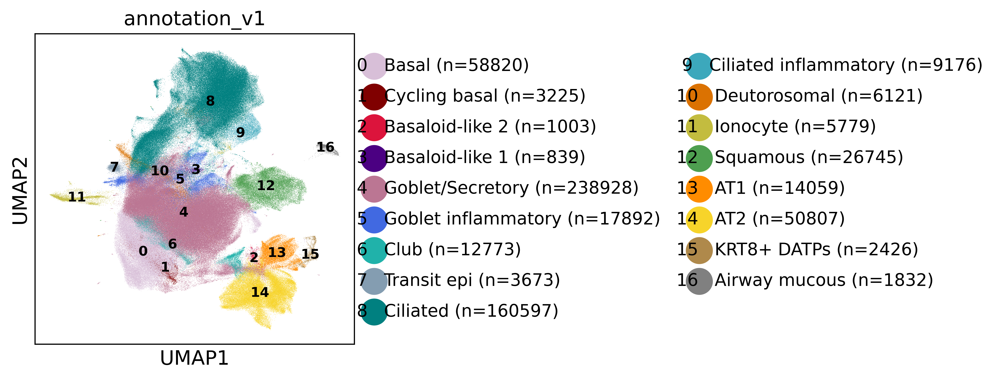

In [214]:
sk.plot_embedding(adata, basis='umap', groupby=['annotation_v1'], annot="full")

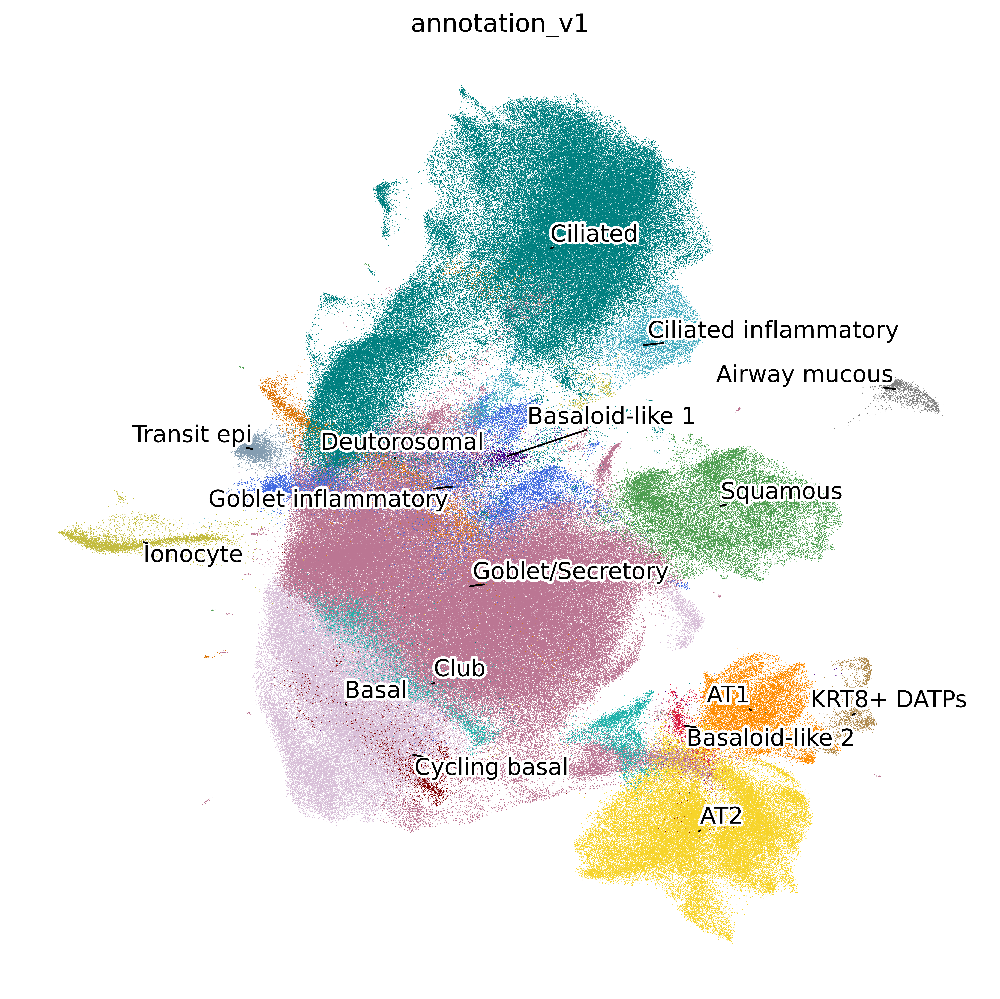

In [218]:
from adjustText import adjust_text
from matplotlib import patheffects
import matplotlib.patheffects as path_effects

def gen_mpl_labels(
    adata, groupby, exclude=(), ax=None, adjust_kwargs=None, text_kwargs=None
):
    if adjust_kwargs is None:
        adjust_kwargs = {"text_from_points": False}
    if text_kwargs is None:
        text_kwargs = {}

    medians = {}

    for g, g_idx in adata.obs.groupby(groupby).groups.items():
        if g in exclude:
            continue
        medians[g] = np.median(adata[g_idx].obsm["X_umap"], axis=0)

    if ax is None:
        texts = [
            plt.text(x=x, y=y, s=k, **text_kwargs) for k, (x, y) in medians.items()
        ]
    else:
        texts = [ax.text(x=x, y=y, s=k, **text_kwargs) for k, (x, y) in medians.items()]

    adjust_text(texts, **adjust_kwargs)
    
with plt.rc_context({"figure.figsize": (8, 8), "figure.dpi": 300, "figure.frameon": False}):
    ax = sc.pl.umap(adata, color="annotation_v1", show=False, size = 1, legend_loc=None, frameon=False)
    gen_mpl_labels(
        adata,
        "annotation_v1",
        ax=ax,
        adjust_kwargs=dict(arrowprops=dict(arrowstyle='-', color='black')),
        text_kwargs=dict(fontsize=13, path_effects=[patheffects.withStroke(linewidth=3, foreground='w')])
    )
    fig = ax.get_figure()
    fig.tight_layout()
    plt.show()

In [81]:
df = pd.crosstab(adata.obs.author_ann_harmonised, adata.obs.annotation_v1)

In [82]:
df.to_csv('author_annv1.csv')

In [219]:
adata.write('/nfs/team205/ac65/ALI_COVID19/datasets_integration_ALI/harmony_final_object_annv1_goblet_good.h5ad')

In [5]:
import scanpy as sc

In [6]:
adata = sc.read_h5ad('/nfs/team205/ac65/ALI_COVID19/datasets_integration_ALI/harmony_final_object_annv1_goblet_good.h5ad')

<AxesSubplot:title={'center':'annotation_v1'}, xlabel='UMAP1', ylabel='UMAP2'>

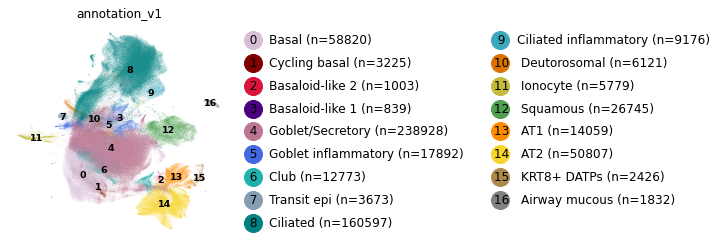

In [7]:
import sctk as sk
sk.plot_embedding(adata, basis='umap', groupby=['annotation_v1'], annot = "full", frameon = False)

In [8]:
import numpy as np
np.unique(adata.obs.file_of_origin)

array(['Bharat_2020.h5ad', 'Chua_2020.h5ad',
       'Delorey_2021_COVID_only.h5ad', 'Loske_2021.h5ad',
       'Melms_2021.h5ad', 'Trump_2020.h5ad', 'Yoshida_2022.h5ad',
       'Ziegler_2021.h5ad'], dtype=object)

In [9]:
adata.obs.study=adata.obs.file_of_origin

In [10]:
np.unique(adata.obs.study)

array(['Bharat_2020.h5ad', 'Chua_2020.h5ad',
       'Delorey_2021_COVID_only.h5ad', 'Loske_2021.h5ad',
       'Melms_2021.h5ad', 'Trump_2020.h5ad', 'Yoshida_2022.h5ad',
       'Ziegler_2021.h5ad'], dtype=object)

In [11]:
import pandas as pd

# Rename the value in the 'study' column
adata.obs['study'] = pd.Categorical(adata.obs['study'])
adata.obs['study'] = adata.obs['study'].cat.rename_categories({'Bharat_2020.h5ad': 'Bharat_2020'})
adata.obs['study'] = adata.obs['study'].cat.rename_categories({'Chua_2020.h5ad': 'Chua_2020'})
adata.obs['study'] = adata.obs['study'].cat.rename_categories({'Delorey_2021_COVID_only.h5ad': 'Delorey_2021'})
adata.obs['study'] = adata.obs['study'].cat.rename_categories({'Loske_2021.h5ad': 'Loske_2021'})
adata.obs['study'] = adata.obs['study'].cat.rename_categories({'Melms_2021.h5ad': 'Melms_2021'})
adata.obs['study'] = adata.obs['study'].cat.rename_categories({'Trump_2020.h5ad': 'Trump_2020'})
adata.obs['study'] = adata.obs['study'].cat.rename_categories({'Yoshida_2022.h5ad': 'Yoshida_2022'})
adata.obs['study'] = adata.obs['study'].cat.rename_categories({'Ziegler_2021.h5ad': 'Ziegler_2021'})

In [12]:
adata

AnnData object with n_obs × n_vars = 614695 × 17591
    obs: 'n_genes', 'n_UMI', 'percent_mito', 'method', 'doublet', 'predicted_celltype', 'compartment', 'Cluster', 'SubCluster', 'Viral+', 'leiden_res_2', 'leiden_res_1.3', 'donor', 'disease', 'age', 'age_group', 'status', 'age_status', 'file_of_origin', 'sample_id', 'Sex', 'Age_bin', 'Group', 'Ethnicity_inferred', 'Smoker', 'COVID_status', 'COVID_severity', 'First_symptoms_hospitalisation_interval', 'First_symptoms_collection_interval', 'Positive_test_collection_interval', 'Sample_location', 'Kit_version', 'dataset', 'Sanger_sample_ID', 'Cell_type_annotation_level3', 'Cell_type_annotation_level1', 'Cell_type_annotation_level2', 'log1p_n_counts', 'log1p_n_genes', 'percent_ribo', 'n_counts_total_sarscov2', 'percent_total_sarscov2', 'n_counts_sarscov2', 'percent_sarscov2', 'scrublet_score', 'donor_id', 'Age', 'Peak_Respiratory_Support_WHO_Score', 'Bloody_Swab', 'Percent_Mitochondrial', 'SARSCoV2_PCR_Status', 'SARSCoV2_PCR_Status_and_WHO_

In [13]:
# Define the desired order of y-labels
adata.obs['age_status'].cat.reorder_categories(['paediatric-Healthy', 'paediatric-COVID19', 'paediatric-Post-COVID', 
                'adult-Healthy', 'adult-COVID19', 'adult-Post-COVID', 'adult-Other PF', 
                'elderly-Healthy', 'elderly-COVID19', 'elderly-IPF', 'elderly-Other PF'])  # Replace with your desired order

Delorey_2021_COVID_only.h5ad:02-P005175-S053-R01-AATCACGAGGGTCACA    elderly-COVID19
Delorey_2021_COVID_only.h5ad:02-P005175-S053-R01-GGTAACTAGTCCTACA    elderly-COVID19
Delorey_2021_COVID_only.h5ad:02-P005175-S053-R01-CATCCGTTCGCAAGAG    elderly-COVID19
Delorey_2021_COVID_only.h5ad:02-P005175-S053-R01-TTCGGTCAGCTTTCCC    elderly-COVID19
Delorey_2021_COVID_only.h5ad:02-P005175-S053-R01-TTAGGCATCCTCACTG    elderly-COVID19
                                                                          ...       
Melms_2021.h5ad:AGCTTCCAGGCATGCA-1_27                                elderly-COVID19
Melms_2021.h5ad:GCACGGTCAGAAGTTA-1_27                                elderly-COVID19
Melms_2021.h5ad:TTGTGGATCATAGGCT-1_27                                elderly-COVID19
Melms_2021.h5ad:GCCGATGAGTAAACGT-1_27                                elderly-COVID19
Melms_2021.h5ad:AGGGTGAGTATCAGGG-1_27                                elderly-COVID19
Name: age_status, Length: 614695, dtype: category
Categories (11,

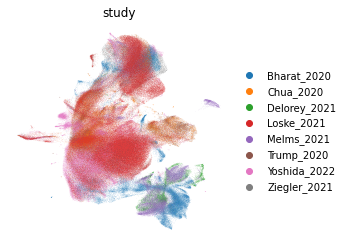

In [14]:
sc.pl.umap(adata, color=['study'], frameon=False)

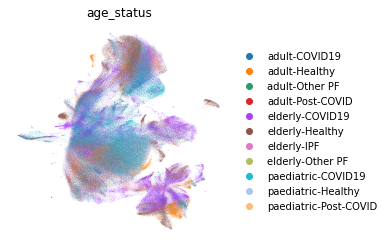

In [15]:
sc.pl.umap(adata, color=['age_status'], frameon=False)

In [16]:
# Define the desired order of labels in the legend
desired_order = ['paediatric-Healthy', 'paediatric-COVID19', 'paediatric-Post-COVID', 
                'adult-Healthy', 'adult-COVID19', 'adult-Post-COVID', 'adult-Other PF', 
                'elderly-Healthy', 'elderly-COVID19', 'elderly-IPF', 'elderly-Other PF']  # Replace with your desired order

# annotation of inflammatory cells

In [17]:
# Subset data for fine-tuning
clusters_to_refine = ['Goblet inflammatory']  # Example: clusters to be fine-tuned
adata_refine = adata[adata.obs['annotation_v1'].isin(clusters_to_refine)]

In [18]:
adata_refine

View of AnnData object with n_obs × n_vars = 17892 × 17591
    obs: 'n_genes', 'n_UMI', 'percent_mito', 'method', 'doublet', 'predicted_celltype', 'compartment', 'Cluster', 'SubCluster', 'Viral+', 'leiden_res_2', 'leiden_res_1.3', 'donor', 'disease', 'age', 'age_group', 'status', 'age_status', 'file_of_origin', 'sample_id', 'Sex', 'Age_bin', 'Group', 'Ethnicity_inferred', 'Smoker', 'COVID_status', 'COVID_severity', 'First_symptoms_hospitalisation_interval', 'First_symptoms_collection_interval', 'Positive_test_collection_interval', 'Sample_location', 'Kit_version', 'dataset', 'Sanger_sample_ID', 'Cell_type_annotation_level3', 'Cell_type_annotation_level1', 'Cell_type_annotation_level2', 'log1p_n_counts', 'log1p_n_genes', 'percent_ribo', 'n_counts_total_sarscov2', 'percent_total_sarscov2', 'n_counts_sarscov2', 'percent_sarscov2', 'scrublet_score', 'donor_id', 'Age', 'Peak_Respiratory_Support_WHO_Score', 'Bloody_Swab', 'Percent_Mitochondrial', 'SARSCoV2_PCR_Status', 'SARSCoV2_PCR_Status_a

In [19]:
sc.pp.neighbors(adata_refine)

In [20]:
# Fine-tune Leiden clustering for selected clusters
sc.tl.leiden(adata_refine, resolution=0.2)  # Adjust resolution as needed

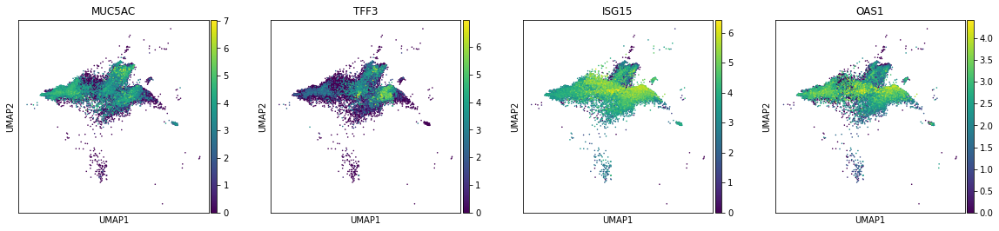

In [21]:
sc.pl.umap(adata_refine, color=['MUC5AC', 'TFF3', 'ISG15', 'OAS1'], ncols = 4, size = 10)

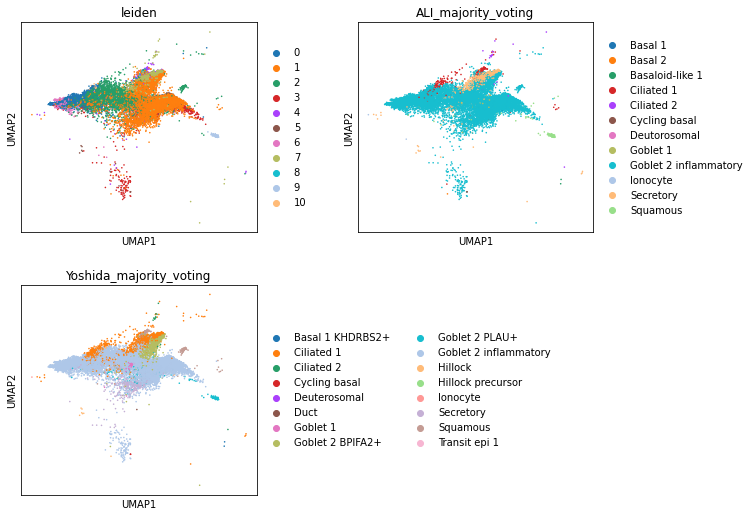

In [22]:
sc.pl.umap(adata_refine, color=['leiden', 'ALI_majority_voting', 'Yoshida_majority_voting'], ncols = 2, size = 10, wspace = 0.3)

In [23]:
np.unique(adata_refine.obs['leiden'])

array(['0', '1', '10', '2', '3', '4', '5', '6', '7', '8', '9'],
      dtype=object)

In [24]:
import matplotlib
sc.set_figure_params(figsize=(20, 6))
matplotlib.rcParams.update({'xtick.labelsize': 12, 'ytick.labelsize': 12})
import seaborn as sns
sns.set_theme(style='white')

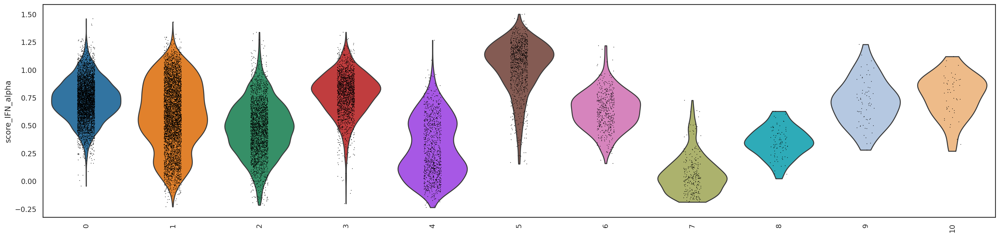

In [25]:
#Calculate IFN_ALPHA SCORE
IFN_ALPHA_genes = [x.strip() for x in open("/nfs/team205/nh3/data/feature_lists/GOBP_RESPONSE_TO_INTERFERON_ALPHA_geneset.txt")]
IFN_ALPHA_genes
sc.tl.score_genes(adata_refine, IFN_ALPHA_genes, score_name="score_IFN_alpha")
sc.pl.violin(adata_refine, 'score_IFN_alpha', groupby='leiden', rotation=90)

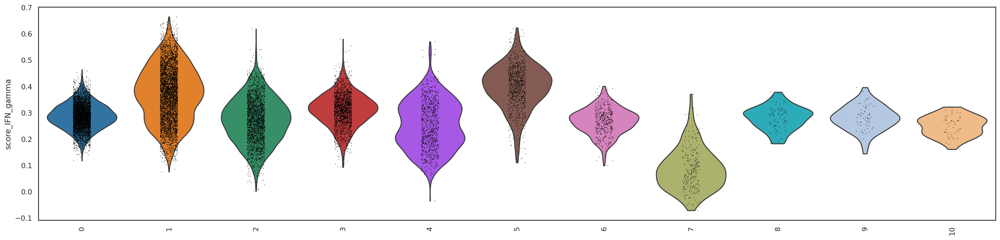

In [26]:
#Calculate IFN_ALPHA SCORE
IFN_GAMMA_genes = [x.strip() for x in open("/nfs/team205/nh3/data/feature_lists/GOBP_RESPONSE_TO_INTERFERON_GAMMA_geneset.txt")]
IFN_GAMMA_genes
sc.tl.score_genes(adata_refine, IFN_GAMMA_genes, score_name="score_IFN_gamma")
sc.pl.violin(adata_refine, 'score_IFN_gamma', groupby='leiden', rotation=90)

In [27]:
# Convert 'leiden' column to categorical
adata_refine.obs['leiden'] = pd.Categorical(adata_refine.obs['leiden'])

In [28]:
marker_genes_dict_2 = {'Basal': ['KRT5', 'KRT17', 'KRT14','KRT15', 'DLK2', 'TP63', 'DAPL1', 'NOTCH1', 'NOTCH3'],
                     'EMT': ['CDH2', 'VIM', 'FN1', 'COL1A1', 'COL3A1', 'LAMA5', 'ITGB6', 'MMP7'], 
                     'Cycling basal': ['MKI67', 'NUSAP1'],
                     'Goblet': ['TFF3','MUC5AC','BPIFA1', 'BPIFA2','MUC5B','TFF1', 'PLAU'], 
                     'Secretory': ['NOS2', 'CAPN13', 'RARRES1', 'SERPINB3', 'AQP5', 'CP', 'PI3'],
                      'Goblet inflammatory': ['CXCL10', 'OAS1', 'IFIT1', 'IFIT3'],  
                     'Club': ['SCGB1A1', 'SCGB3A1'],  
                     'Infected': ['ACE2', 'TMPRSS2'],
                     'Ciliated 1': ['OMG', 'PIFO', 'FOXJ1'], 
                     'Ciliated 2': ['CCDC40'],
                     'Deutorosomal': ['FOXN4', 'CDC20B'], 
                     'Ionocyte': ['FOXI1'], 
                     'Squamous': [ "KRT78"], 
                     'AT1': ['RTKN2', 'CLIC5'], 
                     'AT2': ['SFTPA1', 'SFTPA2', 'WIF1', 'HHIP', 'CA2', 'ETV5'], 
                     'KRT8+': ['KRT8', 'TP53']
                     }

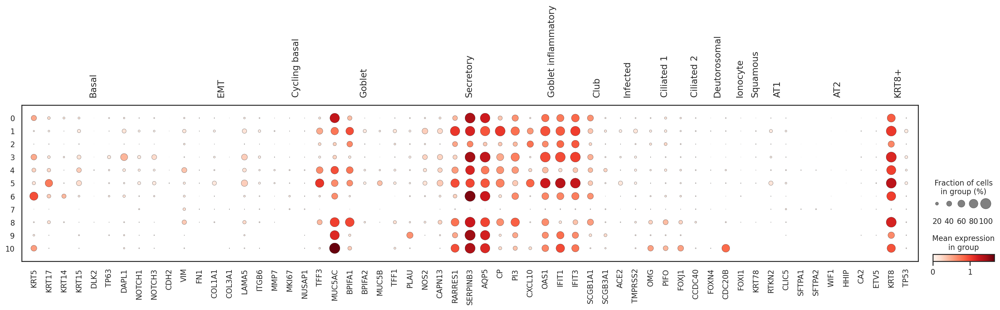

In [29]:
sc.pl.dotplot(adata_refine, marker_genes_dict_2, groupby='leiden', log = True)

In [30]:
adata_refine.obs['leiden'].replace({'0': 'Goblet inflammatory',
                                    '1': 'Goblet inflammatory',
                                    '2': 'Goblet inflammatory',
                                    '3': 'Goblet inflammatory', 
                                   '4': 'Goblet inflammatory',
                                    '5': 'Goblet inflammatory',
                                    '6': 'Goblet inflammatory', 
                                   '8': 'Goblet inflammatory',
                                   '9': 'Goblet inflammatory',
                                    '10': 'Goblet inflammatory',}, inplace=True)

In [31]:
np.unique(adata_refine.obs['leiden'])

array(['7', 'Goblet inflammatory'], dtype=object)

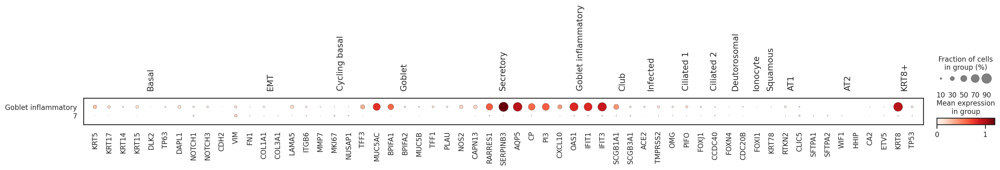

In [32]:
sc.pl.dotplot(adata_refine, marker_genes_dict_2, groupby='leiden', log = True)

In [33]:
# Subset data to include only cells from Leiden cluster 13
subset_adata = adata_refine[adata_refine.obs['leiden'] == 'Goblet inflammatory']

In [56]:
import matplotlib.pyplot as plt

# Group the data by leiden clusters and age groups
grouped_data = subset_adata.obs.groupby(['annotation_v1', 'age_status_granular']).size().unstack()
grouped_data

age_status_granular,adolescent-COVID19,adolescent-Healthy,adult-COVID19,adult-Healthy,adult-Post-COVID,elderly-COVID19,elderly-Healthy,elderly-IPF,old_adult-COVID19,old_adult-Healthy,old_adult-IPF,old_adult-Other PF,paediatric-COVID19,paediatric-Healthy,paediatric-Post-COVID,young_adult-COVID19,young_adult-Healthy
annotation_v1,,,,,,,,,,,,,,,,,
Goblet inflammatory,663,169,2133,99,1,8248,65,5,764,16,9,4,4429,440,6,558,17


In [57]:
subset_adata.obs['age_status'].value_counts()

elderly-COVID19          9012
paediatric-COVID19       5092
adult-COVID19            2691
paediatric-Healthy        609
adult-Healthy             116
elderly-Healthy            81
elderly-IPF                14
paediatric-Post-COVID       6
elderly-Other PF            4
adult-Post-COVID            1
Name: age_status, dtype: int64

In [58]:
subset_adata.obs['file_of_origin'].value_counts()

Yoshida_2022.h5ad               9737
Loske_2021.h5ad                 5515
Chua_2020.h5ad                  1479
Trump_2020.h5ad                  825
Bharat_2020.h5ad                  52
Ziegler_2021.h5ad                 16
Delorey_2021_COVID_only.h5ad       2
Name: file_of_origin, dtype: int64

In [59]:
subset_adata.obs['donor_harmonised'].value_counts()

AP10            7633
BIH-c-CoV-09    1159
BIH-c-CoV-18     973
PP9              843
BIH-a-CoV-18     564
                ... 
BIH-c-Con-05       1
NP37               1
BIH-SCV2-09        1
NP47               1
VUILD65            1
Name: donor_harmonised, Length: 215, dtype: int64

In [60]:
cluster_data = subset_adata.obs.groupby('age_status').size()
cluster_data.sort_values(ascending=False)

age_status
elderly-COVID19          9012
paediatric-COVID19       5092
adult-COVID19            2691
paediatric-Healthy        609
adult-Healthy             116
elderly-Healthy            81
elderly-IPF                14
paediatric-Post-COVID       6
elderly-Other PF            4
adult-Post-COVID            1
dtype: int64

In [61]:
# Group the filtered data by age groups and count the number of cells
grouped_data = adata.obs.groupby('age_status').size()
grouped_data.sort_values(ascending=False)

age_status
elderly-COVID19          158028
paediatric-Healthy       112708
paediatric-COVID19        91186
adult-COVID19             80719
elderly-Healthy           78892
adult-Healthy             55710
elderly-IPF               24877
adult-Post-COVID           5038
elderly-Other PF           3798
paediatric-Post-COVID      3545
adult-Other PF              194
dtype: int64

In [62]:
# Normalize the number of cells to a total of 5000 cells per age group
normalized_data = (cluster_data / grouped_data) * 5000

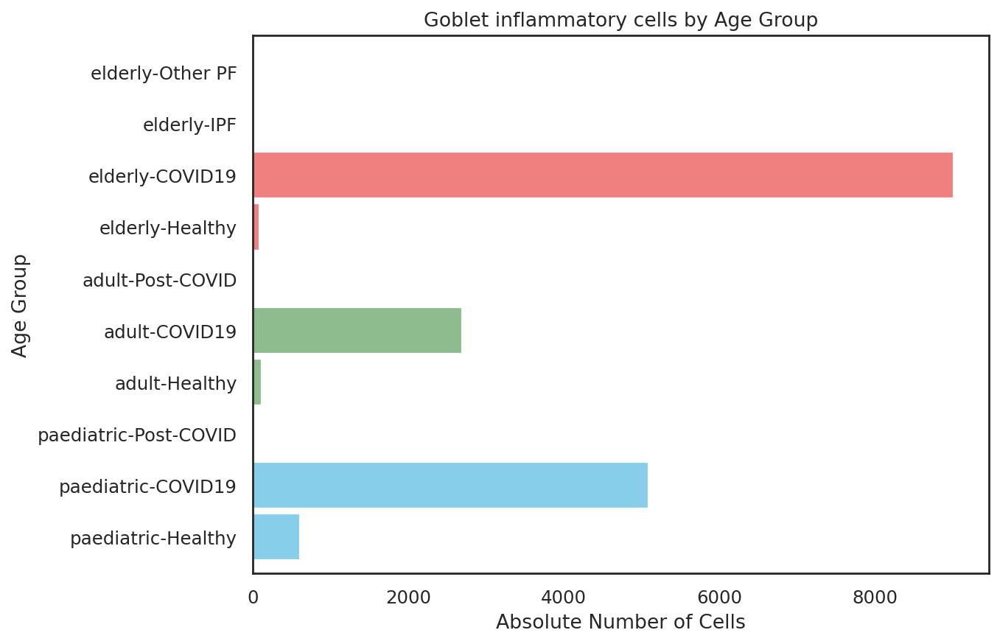

In [63]:
# Extract y-labels
y_labels = cluster_data.index

# Define the desired order of y-labels
desired_order = ['paediatric-Healthy', 'paediatric-COVID19', 'paediatric-Post-COVID', 'adolescent-Healthy', 'adolescent-COVID19',  
                'young_adult-Healthy' , 'young_adult-COVID19', 'adult-Healthy', 'adult-COVID19', 'adult-Post-COVID', 'adult-Other PF', 
                'old_adult-Healthy', 'old_adult-COVID19', 'old_adult-IPF', 'old_adult-Other PF', 'elderly-Healthy', 'elderly-COVID19', 'elderly-IPF', 'elderly-Other PF']  # Replace with your desired order

# Reorder y-labels
ordered_labels = [label for label in desired_order if label in y_labels]

# Create a list of colors corresponding to the reordered y-labels
colors = ['skyblue', 'skyblue', 
         'darkseagreen', 'darkseagreen', 'darkseagreen', 
         "lightcoral", "lightcoral", "lightcoral", "lightcoral"]  # Replace with your desired colors

# Plot stacked bar plot with reordered y-labels and colors
plt.figure(figsize=(8, 6))
cluster_data.loc[ordered_labels].plot(kind='barh', stacked=True, color=colors, width=0.9)

# Set labels and title
plt.xlabel('Absolute Number of Cells')
plt.ylabel('Age Group')
plt.title('Goblet inflammatory cells by Age Group')

# Remove grid lines
plt.grid(False)

# Show the plot
plt.show()

In [64]:
cluster_data = cluster_data[['paediatric-Healthy', 'paediatric-COVID19','adult-Healthy', 'adult-COVID19', 'elderly-Healthy', 'elderly-COVID19']]

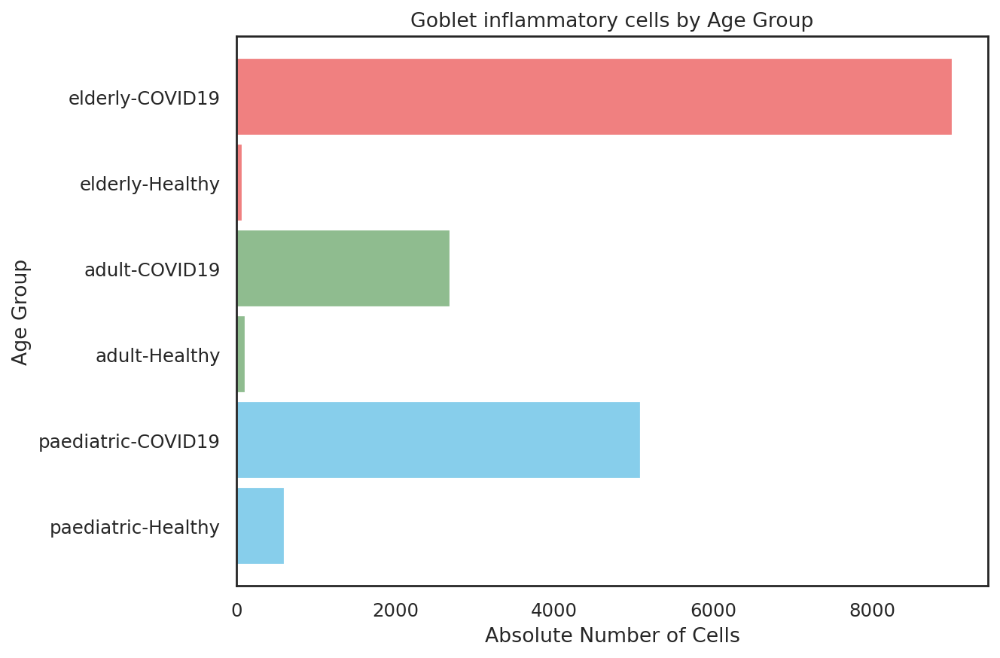

In [65]:
# Extract y-labels
y_labels = cluster_data.index

# Define the desired order of y-labels
desired_order = ['paediatric-Healthy', 'paediatric-COVID19','adult-Healthy', 'adult-COVID19', 'elderly-Healthy', 'elderly-COVID19']  # Replace with your desired order

# Reorder y-labels
ordered_labels = [label for label in desired_order if label in y_labels]

# Create a list of colors corresponding to the reordered y-labels
colors = ['skyblue', 'skyblue',
         'darkseagreen', 'darkseagreen', 
         "lightcoral", "lightcoral" ]  # Replace with your desired colors

# Plot stacked bar plot with reordered y-labels and colors
plt.figure(figsize=(8, 6))
cluster_data.loc[ordered_labels].plot(kind='barh', stacked=True, color=colors, width=0.9)

# Set labels and title
plt.xlabel('Absolute Number of Cells')
plt.ylabel('Age Group')
plt.title('Goblet inflammatory cells by Age Group')

# Remove grid lines
plt.grid(False)

# Show the plot
plt.show()

In [66]:
normalized_data.sort_values(ascending=False)

age_status
elderly-COVID19          285.139342
paediatric-COVID19       279.209528
adult-COVID19            166.689379
paediatric-Healthy        27.016716
adult-Healthy             10.411057
paediatric-Post-COVID      8.462623
elderly-Other PF           5.265929
elderly-Healthy            5.133600
elderly-IPF                2.813844
adult-Post-COVID           0.992457
adult-Other PF                  NaN
dtype: float64

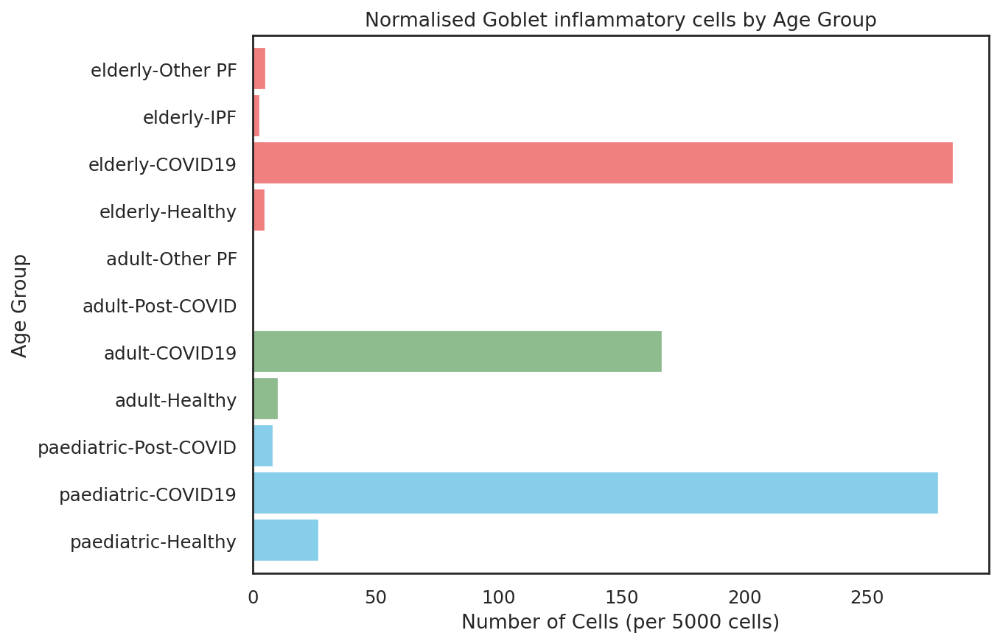

In [67]:
# Extract y-labels
y_labels = normalized_data.index

# Define the desired order of y-labels
desired_order = ['paediatric-Healthy', 'paediatric-COVID19', 'paediatric-Post-COVID', 'adolescent-Healthy', 'adolescent-COVID19',  
                'young_adult-Healthy' , 'young_adult-COVID19', 'adult-Healthy', 'adult-COVID19', 'adult-Post-COVID', 'adult-Other PF', 
                'old_adult-Healthy', 'old_adult-COVID19', 'old_adult-IPF', 'old_adult-Other PF', 'elderly-Healthy', 'elderly-COVID19', 'elderly-IPF', 'elderly-Other PF']  # Replace with your desired order

# Reorder y-labels
ordered_labels = [label for label in desired_order if label in y_labels]

# Create a list of colors corresponding to the reordered y-labels
colors = ['skyblue', 'skyblue', 'skyblue', 
         'darkseagreen', 'darkseagreen', 'darkseagreen', 'darkseagreen', 
         "lightcoral", "lightcoral", "lightcoral", "lightcoral"]  # Replace with your desired colors

# Plot stacked bar plot with reordered y-labels and colors
plt.figure(figsize=(8, 6))
normalized_data.loc[ordered_labels].plot(kind='barh', stacked=True, color=colors, width=0.9)

# Set labels and title
plt.xlabel('Number of Cells (per 5000 cells)')
plt.ylabel('Age Group')
plt.title('Normalised Goblet inflammatory cells by Age Group')

# Remove grid lines
plt.grid(False)

# Show the plot
plt.show()

In [68]:
normalized_data = normalized_data[['paediatric-Healthy', 'paediatric-COVID19','adult-Healthy', 'adult-COVID19', 'elderly-Healthy', 'elderly-COVID19']]

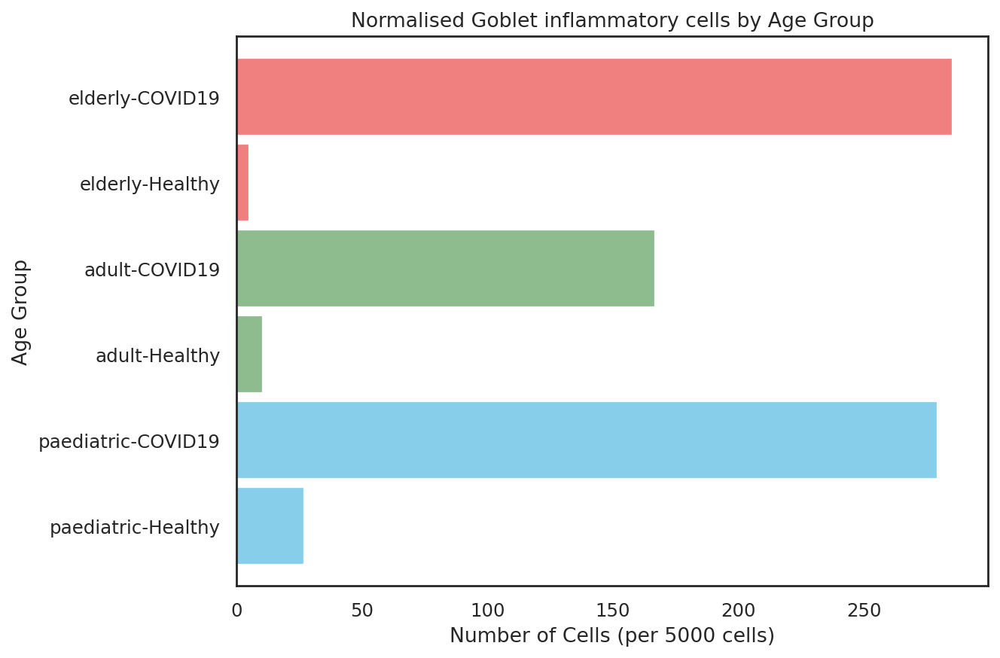

In [69]:
# Extract y-labels
y_labels = normalized_data.index

# Define the desired order of y-labels
desired_order = ['paediatric-Healthy', 'paediatric-COVID19','adult-Healthy', 'adult-COVID19', 'elderly-Healthy', 'elderly-COVID19']  # Replace with your desired order

# Reorder y-labels
ordered_labels = [label for label in desired_order if label in y_labels]

# Create a list of colors corresponding to the reordered y-labels
colors = ['skyblue', 'skyblue',
         'darkseagreen', 'darkseagreen', 
         "lightcoral", "lightcoral" ]  # Replace with your desired colors

# Plot stacked bar plot with reordered y-labels and colors
plt.figure(figsize=(8, 6))
normalized_data.loc[ordered_labels].plot(kind='barh', stacked=True, color=colors, width=0.9)

# Set labels and title
plt.xlabel('Number of Cells (per 5000 cells)')
plt.ylabel('Age Group')
plt.title('Normalised Goblet inflammatory cells by Age Group')

# Remove grid lines
plt.grid(False)

# Show the plot
plt.show()

In [21]:
# Assuming 'adata_refine' is your AnnData object

# Extract the 'leiden' column and indices from adata_refine.obs
leiden_data = adata_refine.obs[['leiden']]
indices = adata_refine.obs_names

# Create a DataFrame from the extracted data
df = pd.DataFrame(leiden_data, index=indices)

# Append the DataFrame to adata using AnnData.obs
adata.obs = adata.obs.join(df, how='left', rsuffix='_inflammatory')

In [22]:
adata.obs['leiden_inflammatory']

Delorey_2021_COVID_only.h5ad:02-P005175-S053-R01-AATCACGAGGGTCACA    NaN
Delorey_2021_COVID_only.h5ad:02-P005175-S053-R01-GGTAACTAGTCCTACA    NaN
Delorey_2021_COVID_only.h5ad:02-P005175-S053-R01-CATCCGTTCGCAAGAG    NaN
Delorey_2021_COVID_only.h5ad:02-P005175-S053-R01-TTCGGTCAGCTTTCCC    NaN
Delorey_2021_COVID_only.h5ad:02-P005175-S053-R01-TTAGGCATCCTCACTG    NaN
                                                                    ... 
Melms_2021.h5ad:AGCTTCCAGGCATGCA-1_27                                NaN
Melms_2021.h5ad:GCACGGTCAGAAGTTA-1_27                                NaN
Melms_2021.h5ad:TTGTGGATCATAGGCT-1_27                                NaN
Melms_2021.h5ad:GCCGATGAGTAAACGT-1_27                                NaN
Melms_2021.h5ad:AGGGTGAGTATCAGGG-1_27                                NaN
Name: leiden_inflammatory, Length: 614695, dtype: category
Categories (3, object): ['Ciliated', 'Ciliated inflammatory', 'Goblet inflammatory']

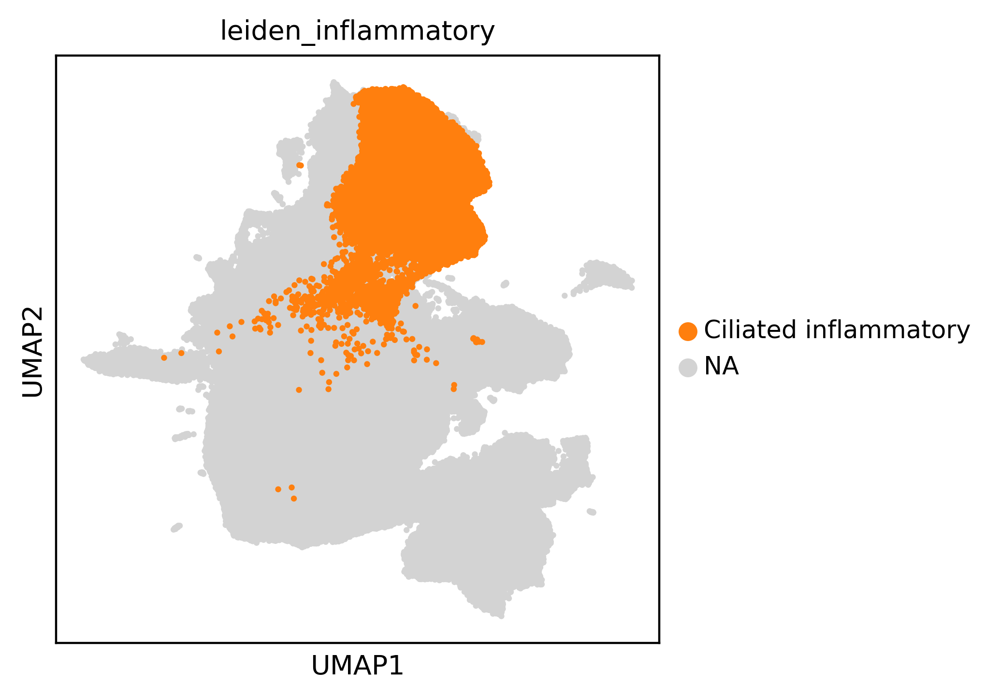

In [23]:
sc.pl.umap(adata, color = "leiden_inflammatory", groups = "Ciliated inflammatory", size = 20)

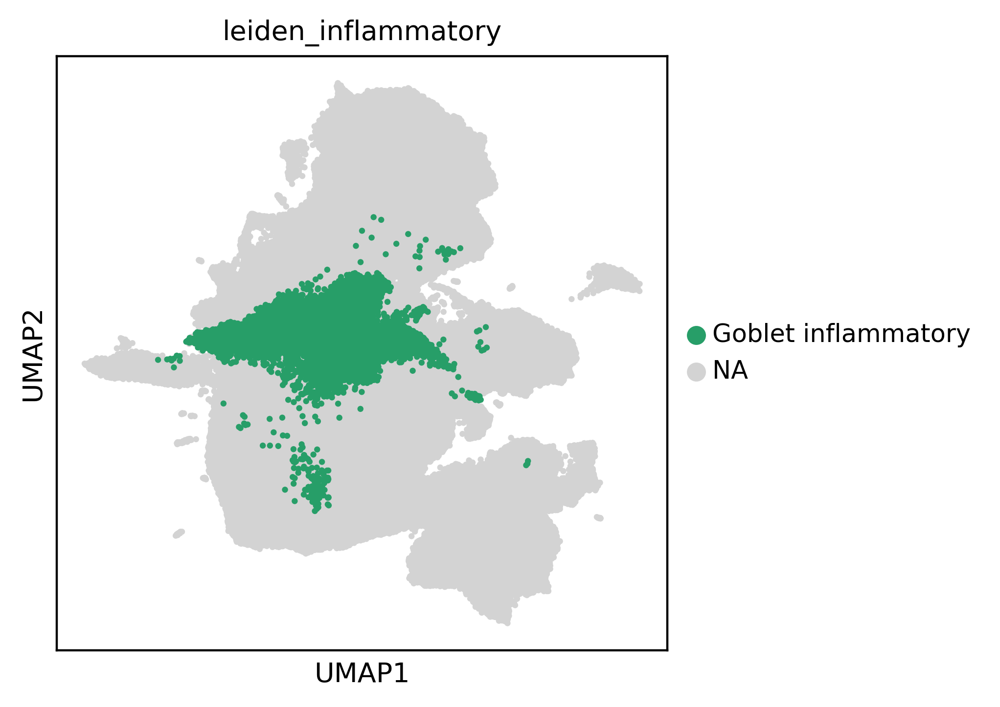

In [24]:
sc.pl.umap(adata, color = "leiden_inflammatory", groups = "Goblet inflammatory", size = 20)

In [27]:
adata.obs['leiden_inflammatory'] = adata.obs['leiden_inflammatory'].astype(str)

In [28]:
np.unique(adata.obs['leiden_inflammatory'])

array(['Ciliated', 'Ciliated inflammatory', 'Goblet inflammatory', 'nan'],
      dtype=object)

In [29]:
adata.obs['leiden_all'] = adata.obs['leiden_combined_coarse']
adata.obs['leiden_all'] = adata.obs['leiden_all'].astype(str)

In [30]:
matching_indices = adata.obs_names.isin(adata_refine.obs_names)
adata.obs.loc[matching_indices, 'leiden_all'] = adata.obs.loc[matching_indices, 'leiden_inflammatory']

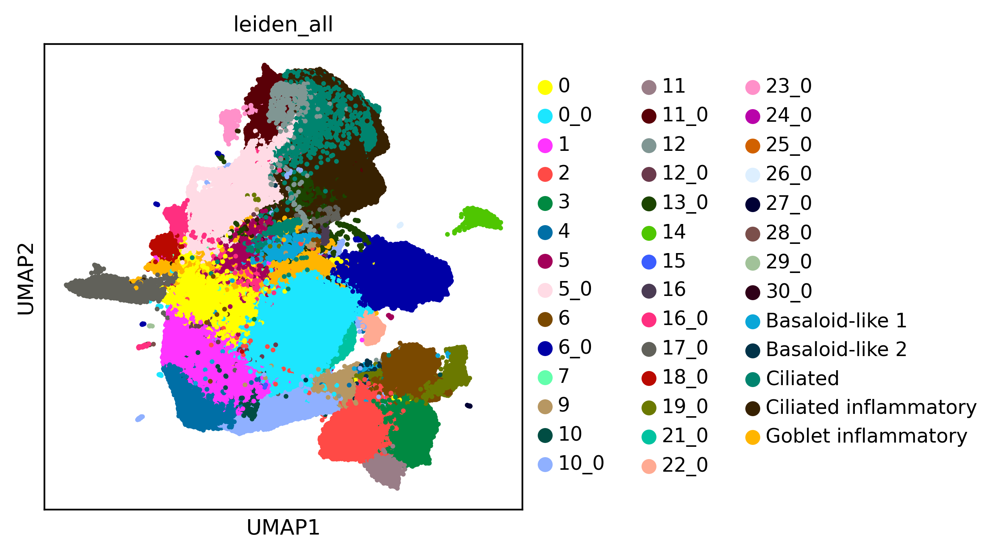

In [31]:
sc.pl.umap(adata, color = 'leiden_all', size = 20)

In [32]:
adata.obs['annotation_v1'] = adata.obs['leiden_all']

In [33]:
adata.obs['annotation_v1'].replace({'0': 'Goblet/Secretory'}, inplace=True)
adata.obs['annotation_v1'].replace({'0_0': 'Goblet/Secretory'}, inplace=True)
adata.obs['annotation_v1'].replace({'7': 'Goblet/Secretory'}, inplace=True)
adata.obs['annotation_v1'].replace({'5': 'Goblet/Secretory'}, inplace=True)
adata.obs['annotation_v1'].replace({'15': 'Goblet/Secretory'}, inplace=True)
adata.obs['annotation_v1'].replace({'16': 'Goblet/Secretory'}, inplace=True)
adata.obs['annotation_v1'].replace({'21_0': 'Goblet/Secretory'}, inplace=True)
adata.obs['annotation_v1'].replace({'24_0': 'Goblet/Secretory'}, inplace=True)
adata.obs['annotation_v1'].replace({'25_0': 'Goblet/Secretory'}, inplace=True)
adata.obs['annotation_v1'].replace({'26_0': 'Goblet/Secretory'}, inplace=True)
adata.obs['annotation_v1'].replace({'27_0': 'Goblet/Secretory'}, inplace=True)
adata.obs['annotation_v1'].replace({'28_0': 'Goblet/Secretory'}, inplace=True)
adata.obs['annotation_v1'].replace({'29_0': 'Goblet/Secretory'}, inplace=True)
adata.obs['annotation_v1'].replace({'30_0': 'Goblet/Secretory'}, inplace=True)
adata.obs['annotation_v1'].replace({'10_0': 'Goblet/Secretory'}, inplace=True)

adata.obs['annotation_v1'].replace({'9': 'Club'}, inplace=True)
adata.obs['annotation_v1'].replace({'12_0': 'Club'}, inplace=True)

adata.obs['annotation_v1'].replace({'1': 'Basal'}, inplace=True)
adata.obs['annotation_v1'].replace({'4': 'Basal'}, inplace=True)
adata.obs['annotation_v1'].replace({'22_0': 'Basal'}, inplace=True)

adata.obs['annotation_v1'].replace({'5_0': 'Ciliated'}, inplace=True)
adata.obs['annotation_v1'].replace({'11_0': 'Ciliated'}, inplace=True)
adata.obs['annotation_v1'].replace({'12': 'Ciliated'}, inplace=True)
adata.obs['annotation_v1'].replace({'13_0': 'Ciliated'}, inplace=True)
adata.obs['annotation_v1'].replace({'23_0': 'Ciliated'}, inplace=True)

adata.obs['annotation_v1'].replace({'2': 'AT2'}, inplace=True)
adata.obs['annotation_v1'].replace({'3': 'AT2'}, inplace=True)
adata.obs['annotation_v1'].replace({'11': 'AT2'}, inplace=True)
adata.obs['annotation_v1'].replace({'6': 'AT1'}, inplace=True)

adata.obs['annotation_v1'].replace({'10': 'Cycling basal'}, inplace=True)
adata.obs['annotation_v1'].replace({'6_0': 'Squamous'}, inplace=True)
adata.obs['annotation_v1'].replace({'16_0': 'Deutorosomal'}, inplace=True)
adata.obs['annotation_v1'].replace({'17_0': 'Ionocyte'}, inplace=True)
adata.obs['annotation_v1'].replace({'18_0': 'Transit epi'}, inplace=True)
adata.obs['annotation_v1'].replace({'19_0': 'KRT8+ DATPs'}, inplace=True)
adata.obs['annotation_v1'].replace({'14': 'Airway mucous'}, inplace=True)

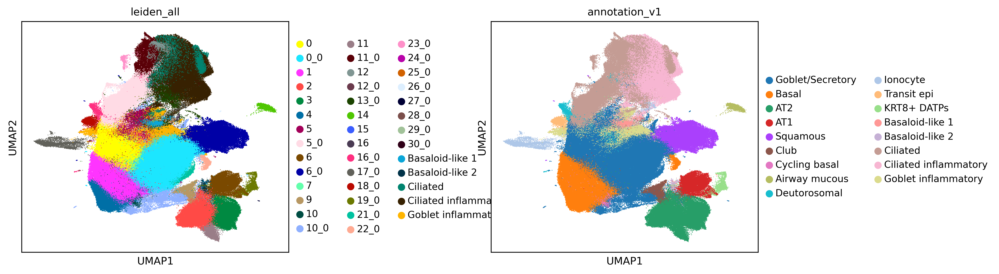

In [34]:
sc.set_figure_params(dpi=200, fontsize=10)
sc.pl.umap(adata, color = ['leiden_all', 'annotation_v1'], size = 2, wspace = 0.6)

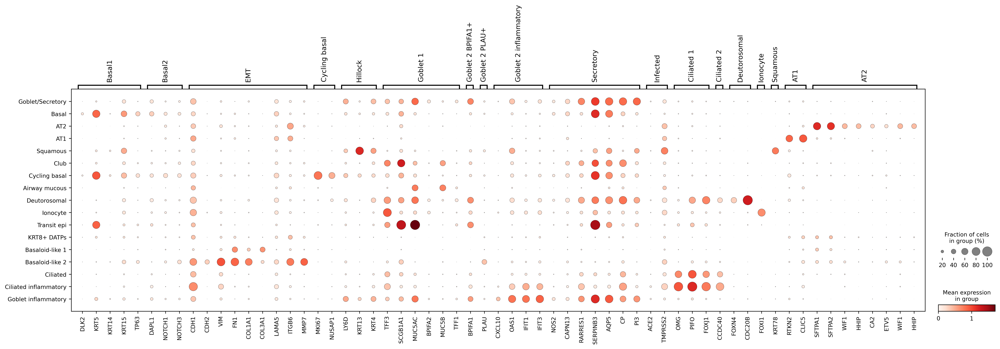

In [35]:
sc.pl.dotplot(adata, marker_genes_dict_2, groupby='annotation_v1', log = True)

In [70]:
adata

AnnData object with n_obs × n_vars = 614695 × 17591
    obs: 'n_genes', 'n_UMI', 'percent_mito', 'method', 'doublet', 'predicted_celltype', 'compartment', 'Cluster', 'SubCluster', 'Viral+', 'leiden_res_2', 'leiden_res_1.3', 'donor', 'disease', 'age', 'age_group', 'status', 'age_status', 'file_of_origin', 'sample_id', 'Sex', 'Age_bin', 'Group', 'Ethnicity_inferred', 'Smoker', 'COVID_status', 'COVID_severity', 'First_symptoms_hospitalisation_interval', 'First_symptoms_collection_interval', 'Positive_test_collection_interval', 'Sample_location', 'Kit_version', 'dataset', 'Sanger_sample_ID', 'Cell_type_annotation_level3', 'Cell_type_annotation_level1', 'Cell_type_annotation_level2', 'log1p_n_counts', 'log1p_n_genes', 'percent_ribo', 'n_counts_total_sarscov2', 'percent_total_sarscov2', 'n_counts_sarscov2', 'percent_sarscov2', 'scrublet_score', 'donor_id', 'Age', 'Peak_Respiratory_Support_WHO_Score', 'Bloody_Swab', 'Percent_Mitochondrial', 'SARSCoV2_PCR_Status', 'SARSCoV2_PCR_Status_and_WHO_

In [77]:
pd.crosstab(adata.obs.Positive_test_collection_interval, adata.obs.donor_harmonised)

donor_harmonised,AP1,AP4,AP5,AP7,AP8,AP9,AP10,AP11,AP12,AP14,...,PP9,PP10,PP11,PP12,PP13,PP15,PP16,PP17,PP18,PP19
Positive_test_collection_interval,,,,,,,,,,,,,,,,,,,,,
0.0,0,0,0,0,0,0,0,0,0,5772,...,0,0,0,0,0,0,0,0,0,0
1.0,0,5237,3922,5656,0,0,0,0,21,0,...,0,9,0,0,0,0,0,0,0,0
2.0,0,0,0,0,0,1168,10321,2221,0,0,...,1473,0,0,0,0,0,0,0,0,0
3.0,0,0,0,0,0,0,0,0,0,0,...,0,0,204,0,0,0,0,3594,6923,0
4.0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5.0,0,0,0,0,1551,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6.0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,4575,0,0,0
7.0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9.0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,3489,0,0,0,0,0,0


In [83]:
import matplotlib.pyplot as plt

# Group the data by leiden clusters, age groups, and donor
grouped_data = subset_adata.obs.groupby(['annotation_v1', 'age_status', 'donor_harmonised']).size().unstack()

In [84]:
grouped_data

donor_harmonised                           AN9  AN11  AN12  AN13  AP1  AP4  \
annotation_v1       age_status                                               
Goblet inflammatory adult-COVID19            0     0     0     0    0   17   
                    adult-Healthy            4    15     0     0    0    0   
                    adult-Post-COVID         0     0     0     0    0    0   
                    elderly-COVID19          0     0     0     0    1    0   
                    elderly-Healthy          0     0     1     4    0    0   
                    elderly-IPF              0     0     0     0    0    0   
                    elderly-Other PF         0     0     0     0    0    0   
                    paediatric-COVID19       0     0     0     0    0    0   
                    paediatric-Healthy       0     0     0     0    0    0   
                    paediatric-Post-COVID    0     0     0     0    0    0   

donor_harmonised                           AP5  AP7  AP8  AP9  ...  \
annotation_v1       age_status                                 ...   
Goblet inflammatory adult-COVID19            0    0   24    0  ...   
                    adult-Healthy            0    0    0    0  ...   
                    adult-Post-COVID         0    0    0    0  ...   
                    elderly-COVID19         22   11    0    1  ...   
                    elderly-Healthy          0    0    0    0  ...   
                    elderly-IPF              0    0    0    0  ...   
                    elderly-Other PF         0    0    0    0  ...   
                    paediatric-COVID19       0    0    0    0  ...   
                    paediatric-Healthy       0    0    0    0  ...   
                    paediatric-Post-COVID    0    0    0    0  ...   

donor_harmonised                           TX_Recipient  VUHD67  VUHD70  \
annotation_v1       age_status                                            
Goblet inflammatory adult-COVID19                     3       0       0   
                    adult-Healthy                     0      10       0   
                    adult-Post-COVID                  0       0       0   
                    elderly-COVID19                   0       0       0   
                    elderly-Healthy                   0       0       1   
                    elderly-IPF                       0       0       0   
                    elderly-Other PF                  0       0       0   
                    paediatric-COVID19                0       0       0   
                    paediatric-Healthy                0       0       0   
                    paediatric-Post-COVID             0       0       0   

donor_harmonised                           VUHD071  VUILD53  VUILD58  VUILD59  \
annotation_v1       age_status                                                  
Goblet inflammatory adult-COVID19                0        0        0        0   
                    adult-Healthy                1        0        0        0   
                    adult-Post-COVID             0        0        0        0   
                    elderly-COVID19              0        0        0        0   
                    elderly-Healthy              0        0        0        0   
                    elderly-IPF                  0        5        0        2   
                    elderly-Other PF             0        0        4        0   
                    paediatric-COVID19           0        0        0        0   
                    paediatric-Healthy           0        0        0        0   
                    paediatric-Post-COVID        0        0        0        0   

donor_harmonised                           VUILD60  VUILD61  VUILD65  
annotation_v1       age_status                                        
Goblet inflammatory adult-COVID19                0        0        0  
                    adult-Healthy                0        0        0  
                    adult-Post-COVID             0        0     

# color bars by donors

In [1]:
import scanpy as sc
import anndata
import pandas as pd
import numpy as np

In [2]:
adata = sc.read_h5ad('/nfs/team205/ac65/ALI_COVID19/datasets_integration_ALI/harmony_final_object_annv1_goblet_good.h5ad')

In [3]:
adata = adata[adata.obs['age_status'].isin(['adult-COVID19', 'adult-Healthy',  'elderly-COVID19', 'elderly-Healthy','paediatric-COVID19','paediatric-Healthy'])]

In [4]:
import numpy as np
np.unique(adata.obs.file_of_origin)

array(['Bharat_2020.h5ad', 'Chua_2020.h5ad',
       'Delorey_2021_COVID_only.h5ad', 'Loske_2021.h5ad',
       'Melms_2021.h5ad', 'Trump_2020.h5ad', 'Yoshida_2022.h5ad',
       'Ziegler_2021.h5ad'], dtype=object)

In [5]:
adata.obs['study']=adata.obs['file_of_origin']

/tmp/ipykernel_405/421776280.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['study']=adata.obs['file_of_origin']


In [6]:
np.unique(adata.obs.study)

array(['Bharat_2020.h5ad', 'Chua_2020.h5ad',
       'Delorey_2021_COVID_only.h5ad', 'Loske_2021.h5ad',
       'Melms_2021.h5ad', 'Trump_2020.h5ad', 'Yoshida_2022.h5ad',
       'Ziegler_2021.h5ad'], dtype=object)

In [7]:
import pandas as pd

# Rename the value in the 'study' column
adata.obs['study'] = pd.Categorical(adata.obs['study'])
adata.obs['study'] = adata.obs['study'].cat.rename_categories({'Bharat_2020.h5ad': 'Bharat_2020'})
adata.obs['study'] = adata.obs['study'].cat.rename_categories({'Chua_2020.h5ad': 'Chua_2020'})
adata.obs['study'] = adata.obs['study'].cat.rename_categories({'Delorey_2021_COVID_only.h5ad': 'Delorey_2021'})
adata.obs['study'] = adata.obs['study'].cat.rename_categories({'Loske_2021.h5ad': 'Loske_2021'})
adata.obs['study'] = adata.obs['study'].cat.rename_categories({'Melms_2021.h5ad': 'Melms_2021'})
adata.obs['study'] = adata.obs['study'].cat.rename_categories({'Trump_2020.h5ad': 'Trump_2020'})
adata.obs['study'] = adata.obs['study'].cat.rename_categories({'Yoshida_2022.h5ad': 'Yoshida_2022'})
adata.obs['study'] = adata.obs['study'].cat.rename_categories({'Ziegler_2021.h5ad': 'Ziegler_2021'})

In [8]:
np.unique(adata.obs.study)

array(['Bharat_2020', 'Chua_2020', 'Delorey_2021', 'Loske_2021',
       'Melms_2021', 'Trump_2020', 'Yoshida_2022', 'Ziegler_2021'],
      dtype=object)

/home/jovyan/my-conda-envs/celltypist/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


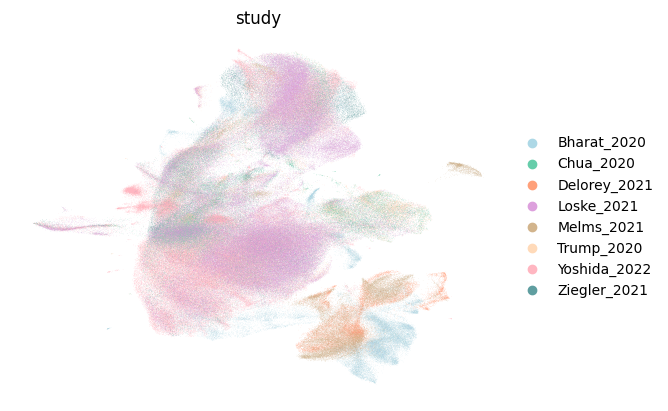

In [9]:
# Define colors for each study
study_colors = {
    'Bharat_2020': 'lightblue',
    'Chua_2020': 'mediumaquamarine',
    'Delorey_2021': 'lightsalmon',
    'Loske_2021': 'plum',
    'Melms_2021': 'tan',
    'Trump_2020': 'peachpuff',
    'Yoshida_2022': 'lightpink',
    'Ziegler_2021': 'cadetblue',
}

# Plot the UMAP with data points colored by study
sc.pl.umap(adata, color='study', palette=study_colors, frameon=False, size = 0.2)

/home/jovyan/my-conda-envs/celltypist/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


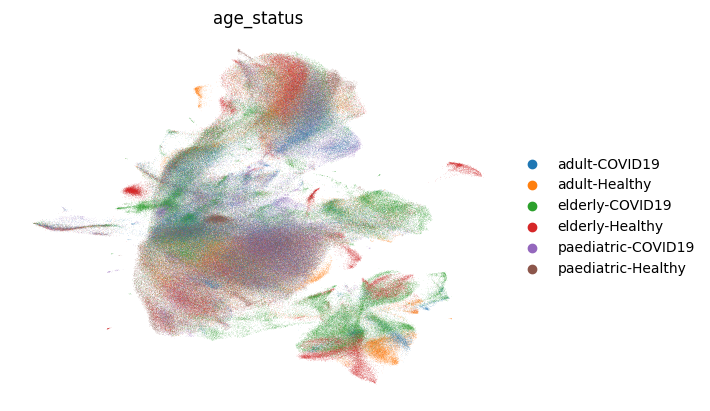

In [10]:
import matplotlib.pyplot as plt
# Define the desired order of labels
desired_order = ['paediatric-Healthy', 'paediatric-COVID19', 
                'adult-Healthy', 'adult-COVID19',  
                'elderly-Healthy', 'elderly-COVID19']  # Replace with your desired order

# Reorder the labels and colors based on the desired order
ordered_labels = [label for label in desired_order if label in adata.obs['age_status']]

# Plot the umap with ordered labels and colors
sc.pl.umap(adata, color=['age_status'], frameon=False, size = 0.2)